# FASTER-RCNN

In [ ]:
!nvidia-smi

Tue Nov  4 12:15:23 2025       
+-----------------------------------------------------------------------------------------+
| NVIDIA-SMI 550.54.15              Driver Version: 550.54.15      CUDA Version: 12.4     |
|-----------------------------------------+------------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id          Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |           Memory-Usage | GPU-Util  Compute M. |
|                                         |                        |               MIG M. |
|=========================================+========================+======================|
|   0  Tesla T4                       Off |   00000000:00:04.0 Off |                    0 |
| N/A   56C    P8             10W /   70W |       0MiB /  15360MiB |      0%      Default |
|                                         |                        |                  N/A |
+-----------------------------------------+-----

In [ ]:
!pip install roboflow
!pip install torch torchvision torchaudio --index-url https://download.pytorch.org/whl/cu118
!git clone https://github.com/facebookresearch/detectron2.git
%cd detectron2
!python -m pip install -e .


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 89.9/89.9 kB 5.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 66.8/66.8 kB 4.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 49.9/49.9 MB 20.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.4/1.4 MB 87.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.2/4.2 MB 142.3 MB/s eta 0:00:00
  Attempting uninstall: opencv-python-headless
    Found existing installation: opencv-python-headless 4.12.0.88
    Uninstalling opencv-python-headless-4.12.0.88:
      Successfully uninstalled opencv-python-headless-4.12.0.88
  Attempting uninstall: idna
    Found existing installation: idna 3.11
    Uninstalling idna-3.11:
      Successfully uninstalled idna-3.11
Looking in indexes: https://download.pytorch.org/whl/cu118
Cloning into 'detectron2'...
remote: Enumerating objects: 15920, done.
remote: Counting objects: 100% (2/2), done.
remote: Compressing objects: 100% (2/2), done.
remote: Total 15920 

In [ ]:
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()
print("Detectron2 installed and working!")


Detectron2 installed and working!


In [ ]:
import torch
import torchvision
from torchvision.models.detection.faster_rcnn import FastRCNNPredictor
from torch.utils.data import DataLoader, Dataset
import cv2, os
from roboflow import Roboflow

QQP2hmDA6hdwWPeX6IJb

In [ ]:
import os
from getpass import getpass

os.environ['ROBOFLOW_API_KEY'] = getpass('Enter Roboflow API key: ')


Enter Roboflow API key: ··········


In [ ]:
from roboflow import Roboflow
rf = Roboflow(api_key=os.environ["ROBOFLOW_API_KEY"])
project = rf.workspace("tree-soyjd").project("queen-cells-segment-ri9y6-f88wd-p286k-bjq11")
version = project.version(1)
dataset = version.download("coco")


loading Roboflow workspace...
loading Roboflow project...



Extracting Dataset Version Zip to queen-cells-segment-1 in coco:: 100%|██████████| 4572/4572 [00:01<00:00, 4039.18it/s]


In [ ]:
import os, json
from detectron2.data.datasets import register_coco_instances
from detectron2.data import MetadataCatalog, DatasetCatalog
from detectron2.config import get_cfg
from detectron2.engine import DefaultTrainer
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader


In [ ]:
# Define the paths to the JSON files
train_json = "/content/detectron2/queen-cells-segment-1/train/_annotations.coco.json"
val_json = "/content/detectron2/queen-cells-segment-1/valid/_annotations.coco.json"
test_json = "/content/detectron2/queen-cells-segment-1/test/_annotations.coco.json"

In [ ]:
import glob

files = glob.glob("/content/**/*.json", recursive=True)
for f in files:
    print(f)


/content/detectron2/queen-cells-segment-1/train/_annotations.coco.json
/content/detectron2/queen-cells-segment-1/valid/_annotations.coco.json
/content/detectron2/queen-cells-segment-1/test/_annotations.coco.json
/content/sample_data/anscombe.json


In [ ]:
def get_classes_from_json(json_path):
    with open(json_path, 'r') as f:
        data = json.load(f)
    categories = sorted(data["categories"], key=lambda x: x["id"])
    return [c["name"] for c in categories]

class_names = get_classes_from_json(train_json)
print(" Loaded categories:", class_names)


 Loaded categories: ['queen-cells-SS5v-vrW4', 'capped_cell', 'failed_cell', 'matured_cell', 'open_cell', 'semi-matured_cell']


# Data Cleaning

In [ ]:
import json
import shutil

def fix_annotations(json_path):
    with open(json_path, "r") as f:
        data = json.load(f)

    keep = ['capped_cell', 'failed_cell', 'matured_cell', 'open_cell', 'semi-matured_cell']

    new_categories = []
    name_to_newid = {}

    new_id = 0
    for c in data["categories"]:
        if c["name"] in keep:
            name_to_newid[c["id"]] = new_id
            new_categories.append({"id": new_id, "name": c["name"]})
            new_id += 1

    new_annotations = []
    for ann in data["annotations"]:
        old_id = ann["category_id"]
        if old_id in name_to_newid:
            ann["category_id"] = name_to_newid[old_id]
            new_annotations.append(ann)

    data["categories"] = new_categories
    data["annotations"] = new_annotations

    out = json_path.replace(".json", "_clean.json")
    with open(out, "w") as f:
        json.dump(data, f, indent=2)

    print(" Cleaned →", out)

fix_annotations(train_json)
fix_annotations(val_json)
fix_annotations(test_json)


 Cleaned → /content/detectron2/queen-cells-segment-1/train/_annotations.coco_clean.json
 Cleaned → /content/detectron2/queen-cells-segment-1/valid/_annotations.coco_clean.json
 Cleaned → /content/detectron2/queen-cells-segment-1/test/_annotations.coco_clean.json


In [ ]:
import json

def show_classes(path):
    with open(path, "r") as f:
        data = json.load(f)
    print("CLASSES:", [c["name"] for c in data["categories"]])

show_classes("/content/detectron2/queen-cells-segment-1/train/_annotations.coco_clean.json")
show_classes("/content/detectron2/queen-cells-segment-1/valid/_annotations.coco_clean.json")
show_classes("/content/detectron2/queen-cells-segment-1/test/_annotations.coco_clean.json")


CLASSES: ['capped_cell', 'failed_cell', 'matured_cell', 'open_cell', 'semi-matured_cell']
CLASSES: ['capped_cell', 'failed_cell', 'matured_cell', 'open_cell', 'semi-matured_cell']
CLASSES: ['capped_cell', 'failed_cell', 'matured_cell', 'open_cell', 'semi-matured_cell']


# Register Dataset

In [ ]:
from detectron2.data.datasets import register_coco_instances

root = "/content/detectron2/queen-cells-segment-1"

register_coco_instances(
    "queen_train", {},
    f"{root}/train/_annotations.coco_clean.json",
    f"{root}/train"
)

register_coco_instances(
    "queen_val", {},
    f"{root}/valid/_annotations.coco_clean.json",
    f"{root}/valid"
)

register_coco_instances(
    "queen_test", {},
    f"{root}/test/_annotations.coco_clean.json",
    f"{root}/test"
)


In [ ]:
from detectron2.data import MetadataCatalog

CLASSES = [
    "capped_cell",
    "failed_cell",
    "matured_cell",
    "open_cell",
    "semi-matured_cell"
]

for d in ["queen_train", "queen_val", "queen_test"]:
    MetadataCatalog.get(d).thing_classes = CLASSES


In [ ]:
import json

valid_names = [
    "capped_cell",
    "failed_cell",
    "matured_cell",
    "open_cell",
    "semi-matured_cell"
]

json_files = [
    train_json.replace(".json", "_clean.json"),
    val_json.replace(".json", "_clean.json"),
    test_json.replace(".json", "_clean.json"),
]


# Checking ID or Mismatch

In [ ]:
def check_json_classes(json_path):
    print("\nChecking:", json_path)
    with open(json_path, "r") as f:
        data = json.load(f)

    categories = data["categories"]
    ann = data["annotations"]

    print(" Categories found:")
    for c in categories:
        print(f"  id={c['id']}  name={c['name']}")

    errors = False
    for c in categories:
        if c["name"] not in valid_names:
            print(" INVALID NAME:", c)
            errors = True

    ids = sorted([c["id"] for c in categories])
    if ids != list(range(len(valid_names))):
        print(" category_id mismatch! Expected:", list(range(len(valid_names))), "Got:", ids)
        errors = True

    invalid_anns = [a for a in ann if a["category_id"] not in ids]
    if invalid_anns:
        print(" Annotation ID mismatch (wrong category_id)")
        print(" Example:", invalid_anns[:5])
        errors = True

    if not errors:
        print("  All good!")

for js in json_files:
    check_json_classes(js)



Checking: /content/detectron2/queen-cells-segment-1/train/_annotations.coco_clean.json
 Categories found:
  id=0  name=capped_cell
  id=1  name=failed_cell
  id=2  name=matured_cell
  id=3  name=open_cell
  id=4  name=semi-matured_cell
  All good!

Checking: /content/detectron2/queen-cells-segment-1/valid/_annotations.coco_clean.json
 Categories found:
  id=0  name=capped_cell
  id=1  name=failed_cell
  id=2  name=matured_cell
  id=3  name=open_cell
  id=4  name=semi-matured_cell
  All good!

Checking: /content/detectron2/queen-cells-segment-1/test/_annotations.coco_clean.json
 Categories found:
  id=0  name=capped_cell
  id=1  name=failed_cell
  id=2  name=matured_cell
  id=3  name=open_cell
  id=4  name=semi-matured_cell
  All good!


In [ ]:
meta = MetadataCatalog.get("queen_train")
print("Classes:", meta.thing_classes)


Classes: ['capped_cell', 'failed_cell', 'matured_cell', 'open_cell', 'semi-matured_cell']


In [ ]:
import json

path = "/content/detectron2/queen-cells-segment-1/train/_annotations.coco_clean.json"
with open(path, "r") as f:
    data = json.load(f)

print(data)

{'info': {'year': '2025', 'version': '1', 'description': 'Exported from roboflow.com', 'contributor': '', 'url': 'https://app.roboflow.com/datasets/queen-cells-segment-ri9y6-f88wd-p286k-bjq11/1', 'date_created': '2025-11-03T07:33:47+00:00'}, 'licenses': [{'id': 1, 'url': 'https://creativecommons.org/licenses/by/4.0/', 'name': 'CC BY 4.0'}], 'categories': [{'id': 0, 'name': 'capped_cell'}, {'id': 1, 'name': 'failed_cell'}, {'id': 2, 'name': 'matured_cell'}, {'id': 3, 'name': 'open_cell'}, {'id': 4, 'name': 'semi-matured_cell'}], 'images': [{'id': 0, 'license': 1, 'file_name': 'images-4-_jpeg.rf.7f8e961a8867b4cddb291492a60bbcd7.jpg', 'height': 640, 'width': 640, 'date_captured': '2025-11-03T07:33:47+00:00', 'extra': {'name': 'images-4-.jpeg'}}, {'id': 1, 'license': 1, 'file_name': 'IMG_1426_jpeg.rf.4096030f1bdae34caa330faa1e4348c0.jpg', 'height': 640, 'width': 640, 'date_captured': '2025-11-03T07:33:47+00:00', 'extra': {'name': 'IMG_1426.jpeg'}}, {'id': 2, 'license': 1, 'file_name': 'IMG

# Recheck ID

In [ ]:
import json
from collections import Counter

path = "/content/detectron2/queen-cells-segment-1/train/_annotations.coco_clean.json"

with open(path, "r") as f:
    data = json.load(f)

counts = Counter([ann["category_id"] for ann in data["annotations"]])

print("CATEGORY MAP:", {c["id"]: c["name"] for c in data["categories"]})
print()
print("COUNTS:")
for c in data["categories"]:
    cid = c["id"]
    cname = c["name"]
    print(f"ID {cid} → {cname}: {counts.get(cid, 0)}")


CATEGORY MAP: {0: 'capped_cell', 1: 'failed_cell', 2: 'matured_cell', 3: 'open_cell', 4: 'semi-matured_cell'}

COUNTS:
ID 0 → capped_cell: 3483
ID 1 → failed_cell: 978
ID 2 → matured_cell: 7977
ID 3 → open_cell: 4166
ID 4 → semi-matured_cell: 4294


# Configuration

In [ ]:
from detectron2.engine import DefaultTrainer
from detectron2.config import get_cfg
import os

cfg = get_cfg()

cfg.merge_from_file(
    "/content/detectron2/configs/COCO-Detection/faster_rcnn_R_50_FPN_3x.yaml"
)

cfg.DATASETS.TRAIN = ("queen_train",)
cfg.DATASETS.TEST  = ("queen_val",)

cfg.DATALOADER.NUM_WORKERS = 2

cfg.MODEL.WEIGHTS = "detectron2://COCO-Detection/faster_rcnn_R_50_FPN_3x/137849458/model_final_280758.pkl"

cfg.MODEL.RESUME = False
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 5

cfg.OUTPUT_DIR = "/content/queen_output_faster"
os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)

cfg.SOLVER.IMS_PER_BATCH = 2
cfg.SOLVER.BASE_LR = 0.00025
cfg.SOLVER.MAX_ITER = 6000
cfg.SOLVER.STEPS = []

cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 128


# Train Faster RCNN Model

In [ ]:
trainer = DefaultTrainer(cfg)
trainer.resume_or_load(resume=False)
trainer.train()


[11/04 12:33:33 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

model_final_280758.pkl: 167MB [00:00, 233MB/s]                           
roi_heads.box_predictor.bbox_pred.{bias, weight}
roi_heads.box_predictor.cls_score.{bias, weight}


[11/04 12:33:35 d2.engine.train_loop]: Starting training from iteration 0


torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at /pytorch/aten/src/ATen/native/TensorShape.cpp:4322.)


[11/04 12:33:44 d2.utils.events]:  eta: 0:27:44  iter: 19  total_loss: 2.688  loss_cls: 1.811  loss_box_reg: 0.5865  loss_rpn_cls: 0.2194  loss_rpn_loc: 0.02512    time: 0.2864  last_time: 0.2456  data_time: 0.0162  last_data_time: 0.0044   lr: 4.9953e-06  max_mem: 1734M
[11/04 12:33:57 d2.utils.events]:  eta: 0:29:19  iter: 39  total_loss: 2.666  loss_cls: 1.727  loss_box_reg: 0.7076  loss_rpn_cls: 0.2294  loss_rpn_loc: 0.02696    time: 0.3046  last_time: 0.3673  data_time: 0.0094  last_data_time: 0.0051   lr: 9.9902e-06  max_mem: 1734M
[11/04 12:34:03 d2.utils.events]:  eta: 0:29:24  iter: 59  total_loss: 2.333  loss_cls: 1.523  loss_box_reg: 0.5918  loss_rpn_cls: 0.1653  loss_rpn_loc: 0.02425    time: 0.3064  last_time: 0.3234  data_time: 0.0093  last_data_time: 0.0099   lr: 1.4985e-05  max_mem: 1734M
[11/04 12:34:09 d2.utils.events]:  eta: 0:28:22  iter: 79  total_loss: 2.059  loss_cls: 1.33  loss_box_reg: 0.5866  loss_rpn_cls: 0.1788  loss_rpn_loc: 0.0247    time: 0.3016  last_tim

# Evaluate Results

In [ ]:
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader

evaluator = COCOEvaluator("queen_val", cfg, False, output_dir=cfg.OUTPUT_DIR)

val_loader = build_detection_test_loader(cfg, "queen_val")

results = inference_on_dataset(trainer.model, val_loader, evaluator)

print(results)

WARNING [11/04 13:05:01 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass in explicit arguments instead.
WARNING [11/04 13:05:01 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[11/04 13:05:01 d2.data.datasets.coco]: Loaded 200 images in COCO format from /content/detectron2/queen-cells-segment-1/valid/_annotations.coco_clean.json
[11/04 13:05:01 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[11/04 13:05:01 d2.data.common]: Serializing the dataset using: <class 'detectron2.data.common._TorchSerializedList'>
[11/04 13:05:01 d2.data.common]: Serializing 200 elements to byte tensors and concatenating them all ...
[11/04 13:05:01 d2.data.common]: Serialized dataset takes 0.23 MiB
[11/04 13:05:01 d2.evaluation.evaluator]: Start inference on 200 bat

# Get Model Weights

In [ ]:
from google.colab import files

model_path = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")

if os.path.exists(model_path):
    files.download(model_path)
    print(f"Model downloaded successfully from: {model_path}")
else:
    print(f"Model file not found at: {model_path}")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Model downloaded successfully from: /content/queen_output_faster/model_final.pth


# Test Images

In [ ]:
from detectron2.engine import DefaultPredictor

cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
predictor = DefaultPredictor(cfg)

[11/04 13:09:03 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from /content/queen_output_faster/model_final.pth ...


In [ ]:
from detectron2.utils.visualizer import Visualizer, ColorMode
from detectron2.data import MetadataCatalog
import cv2, os

img_dir = "/content/detectron2/queen-cells-segment-1/valid"
output_dir = "/content/detectron2/visual_samples"
os.makedirs(output_dir, exist_ok=True)

for image_name in os.listdir(img_dir):
    if not image_name.lower().endswith((".jpg", ".jpeg", ".png")):
        continue

    img_path = os.path.join(img_dir, image_name)
    im = cv2.imread(img_path)
    if im is None:
        print(" Cannot read:", img_path)
        continue

    outputs = predictor(im)

    v = Visualizer(
        im[:, :, ::-1],
        metadata=MetadataCatalog.get("queen_cells_train"),
        scale=1.2,
        instance_mode=ColorMode.SEGMENTATION
    )

    out = v.draw_instance_predictions(outputs["instances"].to("cpu"))

    save_path = os.path.join(output_dir, image_name)
    cv2.imwrite(save_path, out.get_image()[:, :, ::-1])

print("Done! Check folder:", output_dir)


Done! Check folder: /content/detectron2/visual_samples


In [ ]:
!ls /content
!ls /content/test_images


detectron2  queen_output_faster  sample_data
ls: cannot access '/content/test_images': No such file or directory


In [ ]:
!ls /content/detectron2


build		     dev		 MODEL_ZOO.md		tests
configs		     docker		 projects		tools
datasets	     docs		 queen-cells-segment-1	visual_samples
demo		     GETTING_STARTED.md  README.md
detectron2	     INSTALL.md		 setup.cfg
detectron2.egg-info  LICENSE		 setup.py


In [ ]:
!find /content -type d -name "valid"


/content/detectron2/queen-cells-segment-1/valid


In [ ]:
from detectron2.utils.visualizer import Visualizer, ColorMode
from detectron2.data import MetadataCatalog, DatasetCatalog
import cv2, os
import glob, random

from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg

cfg_faster_rcnn = get_cfg()
cfg_faster_rcnn.merge_from_file("/content/detectron2/configs/COCO-Detection/faster_rcnn_R_50_FPN_3x.yaml")
cfg_faster_rcnn.MODEL.WEIGHTS = "/content/queen_output_faster/model_final.pth"
cfg_faster_rcnn.MODEL.ROI_HEADS.NUM_CLASSES = 5

predictor_faster_rcnn = DefaultPredictor(cfg_faster_rcnn)

img_dir = "/content/detectron2/queen-cells-segment-1/valid"
output_dir = "/content/visualized_output_faster_rcnn"
os.makedirs(output_dir, exist_ok=True)

img_list = glob.glob(f"{img_dir}/*")
sample_imgs = random.sample(img_list, min(6, len(img_list)))

FASTER_RCNN_CLASSES = [
    "capped_cell",
    "failed_cell",
    "matured_cell",
    "open_cell",
    "semi-matured_cell"
]

if "queen_val" in DatasetCatalog.keys():
    DatasetCatalog.remove("queen_val")
if "queen_val" in MetadataCatalog.keys():
    MetadataCatalog.remove("queen_val")

from detectron2.data.datasets import register_coco_instances
root = "/content/detectron2/queen-cells-segment-1"
register_coco_instances(
    "queen_val", {"thing_classes": FASTER_RCNN_CLASSES},
    f"{root}/valid/_annotations.coco_clean.json",
    f"{root}/valid"
)

meta_faster_rcnn = MetadataCatalog.get("queen_val")

for image_path in sample_imgs:
    im = cv2.imread(image_path)
    if im is None:
        print("Cannot read:", image_path)
        continue

    outputs = predictor_faster_rcnn(im)

    confidence_threshold = 0.5
    instances = outputs["instances"].to("cpu")
    if instances.has("scores"):
        keep = instances.scores > confidence_threshold
        instances = instances[keep]

    v = Visualizer(
        im[:, :, ::-1],
        metadata=meta_faster_rcnn,
        scale=1.2,
        instance_mode=ColorMode.IMAGE
    )

    out = v.draw_instance_predictions(instances)

    save_path = os.path.join(output_dir, os.path.basename(image_path))
    cv2.imwrite(save_path, out.get_image()[:, :, ::-1])

print("Done! Check folder:", output_dir)


[11/04 13:11:18 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from /content/queen_output_faster/model_final.pth ...
Cannot read: /content/detectron2/queen-cells-segment-1/valid/_annotations.coco.json
Done! Check folder: /content/visualized_output_faster_rcnn


Found 17 visualized images. Showing 6 random samples.


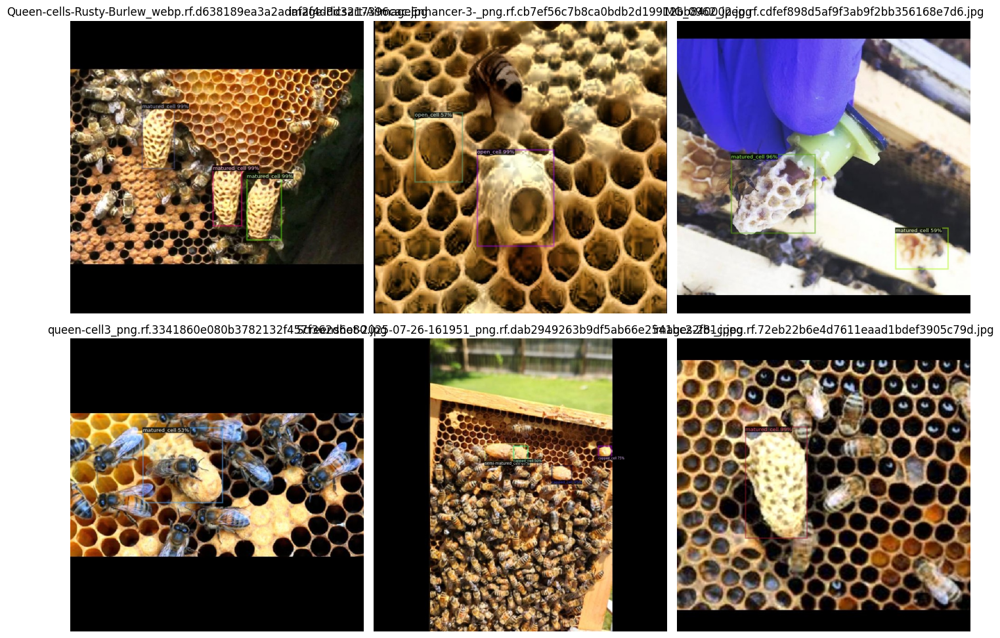

In [ ]:
import matplotlib.pyplot as plt
import cv2, glob, random
import os

output_dir_faster_rcnn = "/content/visualized_output_faster_rcnn"
results_faster_rcnn = glob.glob(f"{output_dir_faster_rcnn}/*")

num_images = len(results_faster_rcnn)
if num_images == 0:
    print(f"No visualized images found in {output_dir_faster_rcnn}. Please run the visualization generation cell first.")
else:
    num_samples = min(6, num_images)
    print(f"Found {num_images} visualized images. Showing {num_samples} random samples.")

    samples_faster_rcnn = random.sample(results_faster_rcnn, num_samples)

    plt.figure(figsize=(14, 10))

    for i, img_path in enumerate(samples_faster_rcnn):
        img = cv2.imread(img_path)
        if img is None:
            print(f"Cannot read image: {img_path}, skipping...")
            continue
        plt.subplot(2, 3, i+1)
        plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
        plt.axis("off")
        plt.title(os.path.basename(img_path))

    plt.tight_layout()
    plt.show()

In [ ]:
from detectron2.utils.visualizer import Visualizer, ColorMode
from detectron2.data import MetadataCatalog, DatasetCatalog
import cv2, os
import glob, random

from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg

cfg_faster_rcnn = get_cfg()
cfg_faster_rcnn.merge_from_file("/content/detectron2/configs/COCO-Detection/faster_rcnn_R_50_FPN_3x.yaml")
cfg_faster_rcnn.MODEL.WEIGHTS = "/content/queen_output_faster/model_final.pth"
cfg_faster_rcnn.MODEL.ROI_HEADS.NUM_CLASSES = 5

predictor_faster_rcnn = DefaultPredictor(cfg_faster_rcnn)

img_dir = "/content/detectron2/queen-cells-segment-1/valid"
output_dir = "/content/visualized_output_faster_rcnn"
os.makedirs(output_dir, exist_ok=True)

img_list = glob.glob(f"{img_dir}/*")
sample_imgs = random.sample(img_list, min(12, len(img_list)))

FASTER_RCNN_CLASSES = [
    "capped_cell",
    "failed_cell",
    "matured_cell",
    "open_cell",
    "semi-matured_cell"
]

if "queen_val" in DatasetCatalog.keys():
    DatasetCatalog.remove("queen_val")
if "queen_val" in MetadataCatalog.keys():
    MetadataCatalog.remove("queen_val")

from detectron2.data.datasets import register_coco_instances
root = "/content/detectron2/queen-cells-segment-1"
register_coco_instances(
    "queen_val", {"thing_classes": FASTER_RCNN_CLASSES},
    f"{root}/valid/_annotations.coco_clean.json",
    f"{root}/valid"
)

meta_faster_rcnn = MetadataCatalog.get("queen_val")

for image_path in sample_imgs:
    im = cv2.imread(image_path)
    if im is None:
        print("Cannot read:", image_path)
        continue

    outputs = predictor_faster_rcnn(im)

    confidence_threshold = 0.5
    instances = outputs["instances"].to("cpu")
    if instances.has("scores"):
        keep = instances.scores > confidence_threshold
        instances = instances[keep]

    v = Visualizer(
        im[:, :, ::-1],
        metadata=meta_faster_rcnn,
        scale=1.2,
        instance_mode=ColorMode.IMAGE
    )

    out = v.draw_instance_predictions(instances)

    save_path = os.path.join(output_dir, os.path.basename(image_path))
    cv2.imwrite(save_path, out.get_image()[:, :, ::-1])

print("Done! Check folder:", output_dir)

[11/04 13:17:19 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from /content/queen_output_faster/model_final.pth ...
Done! Check folder: /content/visualized_output_faster_rcnn


Found 28 visualized images. Showing 6 random samples.


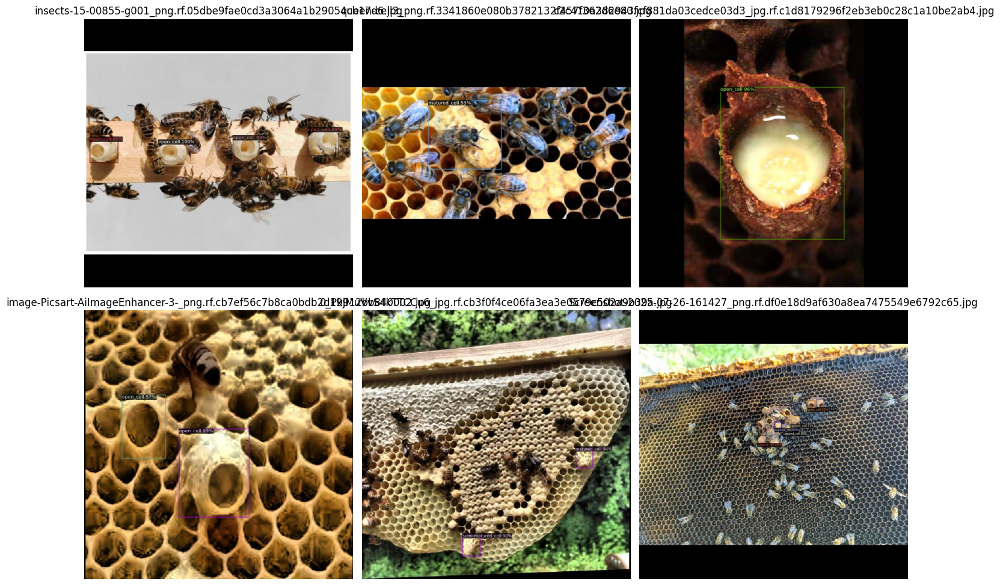

In [ ]:
import matplotlib.pyplot as plt
import cv2, glob, random
import os

output_dir_faster_rcnn = "/content/visualized_output_faster_rcnn"
results_faster_rcnn = glob.glob(f"{output_dir_faster_rcnn}/*")

num_images = len(results_faster_rcnn)
if num_images == 0:
    print(f"No visualized images found in {output_dir_faster_rcnn}. Please run the visualization generation cell first.")
else:
    num_samples = min(6, num_images)
    print(f"Found {num_images} visualized images. Showing {num_samples} random samples.")

    samples_faster_rcnn = random.sample(results_faster_rcnn, num_samples)

    plt.figure(figsize=(14, 10))

    for i, img_path in enumerate(samples_faster_rcnn):
        img = cv2.imread(img_path)
        if img is None:
            print(f"Cannot read image: {img_path}, skipping...")
            continue
        plt.subplot(2, 3, i+1)
        plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
        plt.axis("off")
        plt.title(os.path.basename(img_path))

    plt.tight_layout()
    plt.show()

Found 28 visualized images. Showing 6 random samples.


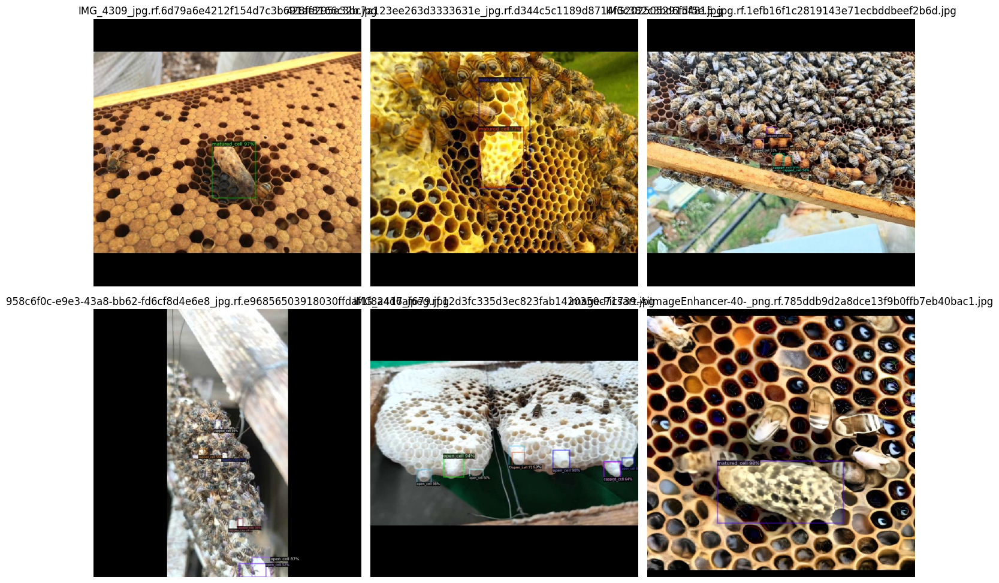

In [ ]:
import matplotlib.pyplot as plt
import cv2, glob, random
import os

output_dir_faster_rcnn = "/content/visualized_output_faster_rcnn"
results_faster_rcnn = glob.glob(f"{output_dir_faster_rcnn}/*")

num_images = len(results_faster_rcnn)
if num_images == 0:
    print(f"No visualized images found in {output_dir_faster_rcnn}. Please run the visualization generation cell first.")
else:
    num_samples = min(6, num_images)
    print(f"Found {num_images} visualized images. Showing {num_samples} random samples.")

    samples_faster_rcnn = random.sample(results_faster_rcnn, num_samples)

    plt.figure(figsize=(14, 10))

    for i, img_path in enumerate(samples_faster_rcnn):
        img = cv2.imread(img_path)
        if img is None:
            print(f"Cannot read image: {img_path}, skipping...")
            continue
        plt.subplot(2, 3, i+1)
        plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
        plt.axis("off")
        plt.title(os.path.basename(img_path))

    plt.tight_layout()
    plt.show()

# Test on valid images

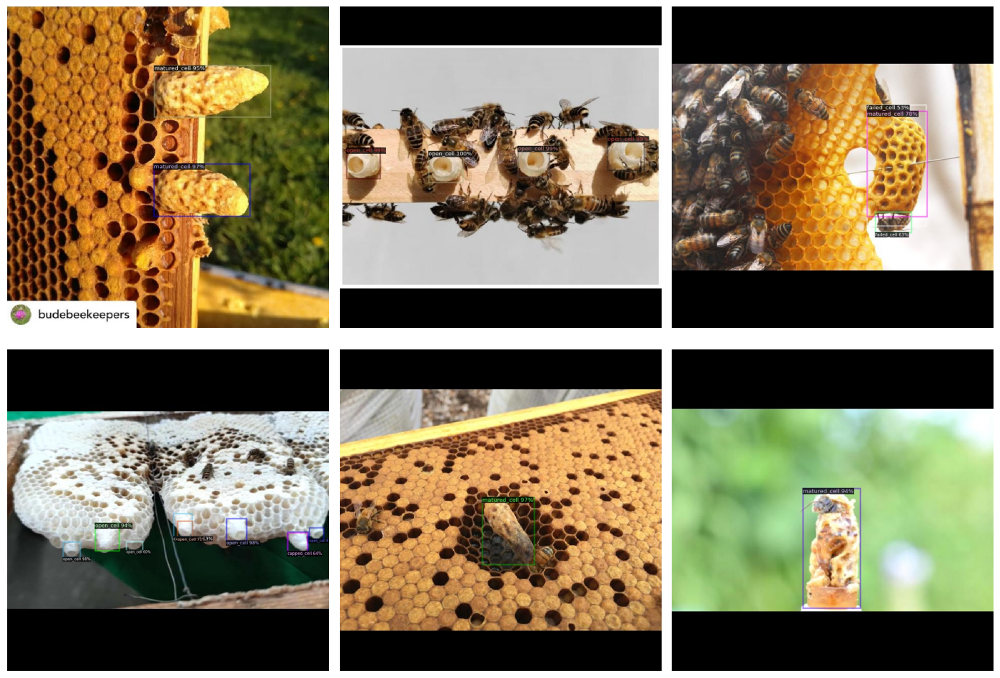

In [ ]:
import matplotlib.pyplot as plt
import cv2, glob, random
import os

output_dir_faster_rcnn = "/content/visualized_output_faster_rcnn"
results_faster_rcnn = glob.glob(f"{output_dir_faster_rcnn}/*")

if not results_faster_rcnn:
    print(f"No visualized images found in {output_dir_faster_rcnn}. Please run the visualization generation cell first.")
else:
    # Pick up to 6 random images without duplicates
    num_samples = min(6, len(results_faster_rcnn))
    samples_faster_rcnn = random.sample(results_faster_rcnn, num_samples)

    plt.figure(figsize=(14, 10))

    for i, img_path in enumerate(samples_faster_rcnn):
        plt.subplot(2, 3, i+1)
        img = cv2.imread(img_path)
        plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
        plt.axis("off")

    plt.tight_layout()
    plt.show()


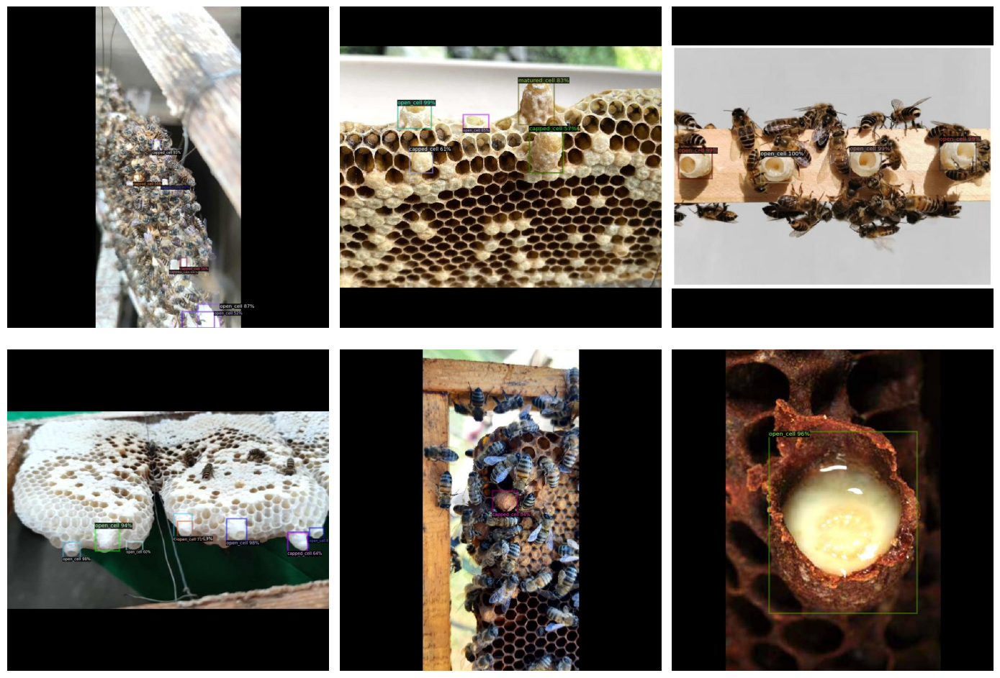

In [ ]:
import matplotlib.pyplot as plt
import cv2, glob, random
import os

output_dir_faster_rcnn = "/content/visualized_output_faster_rcnn"
results_faster_rcnn = glob.glob(f"{output_dir_faster_rcnn}/*")

if not results_faster_rcnn:
    print(f"No visualized images found in {output_dir_faster_rcnn}. Please run the visualization generation cell first.")
else:
    num_samples = 6
    if len(results_faster_rcnn) >= num_samples:
        samples_faster_rcnn = random.sample(results_faster_rcnn, num_samples)
    else:
        samples_faster_rcnn = results_faster_rcnn.copy()
        samples_faster_rcnn += random.choices(results_faster_rcnn, k=num_samples - len(results_faster_rcnn))

    plt.figure(figsize=(14, 10))

    for i, img_path in enumerate(samples_faster_rcnn):
        plt.subplot(2, 3, i+1)
        img = cv2.imread(img_path)
        plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
        plt.axis("off")

    plt.tight_layout()
    plt.show()


# Test on test images

[11/04 13:23:51 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from /content/queen_output_faster/model_final.pth ...
Test images visualized and saved in: /content/visualized_output_faster_rcnn_test


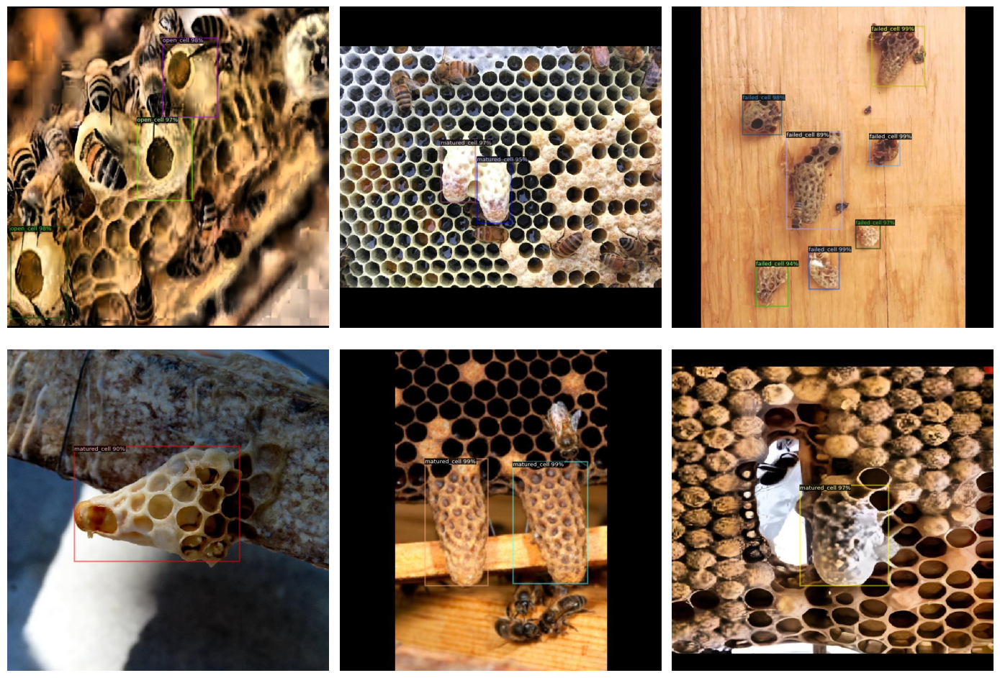

In [ ]:
from detectron2.utils.visualizer import Visualizer, ColorMode
from detectron2.data import MetadataCatalog
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.data.datasets import register_coco_instances
from detectron2.data import DatasetCatalog

import cv2, os, glob, random
import matplotlib.pyplot as plt
import shutil

cfg_faster_rcnn = get_cfg()
cfg_faster_rcnn.merge_from_file("/content/detectron2/configs/COCO-Detection/faster_rcnn_R_50_FPN_3x.yaml")
cfg_faster_rcnn.MODEL.WEIGHTS = "/content/queen_output_faster/model_final.pth"
cfg_faster_rcnn.MODEL.ROI_HEADS.NUM_CLASSES = 5
cfg_faster_rcnn.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5

predictor_faster_rcnn = DefaultPredictor(cfg_faster_rcnn)

FASTER_RCNN_CLASSES = ["capped_cell", "failed_cell", "matured_cell", "open_cell", "semi-matured_cell"]

root_test = "/content/detectron2/queen-cells-segment-1/test"
test_dataset_name = "queen_test"

if test_dataset_name in DatasetCatalog.keys():
    DatasetCatalog.remove(test_dataset_name)
if test_dataset_name in MetadataCatalog.keys():
    MetadataCatalog.remove(test_dataset_name)

register_coco_instances(
    test_dataset_name,
    {"thing_classes": FASTER_RCNN_CLASSES},
    f"{root_test}/_annotations.coco_clean.json",
    root_test
)

meta_faster_rcnn_test = MetadataCatalog.get(test_dataset_name)

output_dir_test = "/content/visualized_output_faster_rcnn_test"
if os.path.exists(output_dir_test):
    shutil.rmtree(output_dir_test)
os.makedirs(output_dir_test, exist_ok=True)

img_list = glob.glob(f"{root_test}/*")
sample_imgs = random.sample(img_list, min(6, len(img_list)))

for image_path in sample_imgs:
    im = cv2.imread(image_path)
    if im is None:
        print("Cannot read:", image_path)
        continue

    outputs = predictor_faster_rcnn(im)
    instances = outputs["instances"].to("cpu")
    if instances.has("scores"):
        keep = instances.scores > cfg_faster_rcnn.MODEL.ROI_HEADS.SCORE_THRESH_TEST
        instances = instances[keep]

    v = Visualizer(
        im[:, :, ::-1],
        metadata=meta_faster_rcnn_test,
        scale=1.2,
        instance_mode=ColorMode.IMAGE
    )
    out = v.draw_instance_predictions(instances)

    save_path = os.path.join(output_dir_test, os.path.basename(image_path))
    cv2.imwrite(save_path, out.get_image()[:, :, ::-1])

print("Test images visualized and saved in:", output_dir_test)

results_test = glob.glob(f"{output_dir_test}/*")
if results_test:
    plt.figure(figsize=(14, 10))
    samples_test = random.sample(results_test, min(6, len(results_test)))
    for i, img_path in enumerate(samples_test):
        plt.subplot(2, 3, i+1)
        img = cv2.imread(img_path)
        plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
        plt.axis("off")
    plt.tight_layout()
    plt.show()
else:
    print("No visualized test images found. Please run the inference step first.")


[11/04 13:24:07 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from /content/queen_output_faster/model_final.pth ...
Test images visualized and saved in: /content/visualized_output_faster_rcnn_test


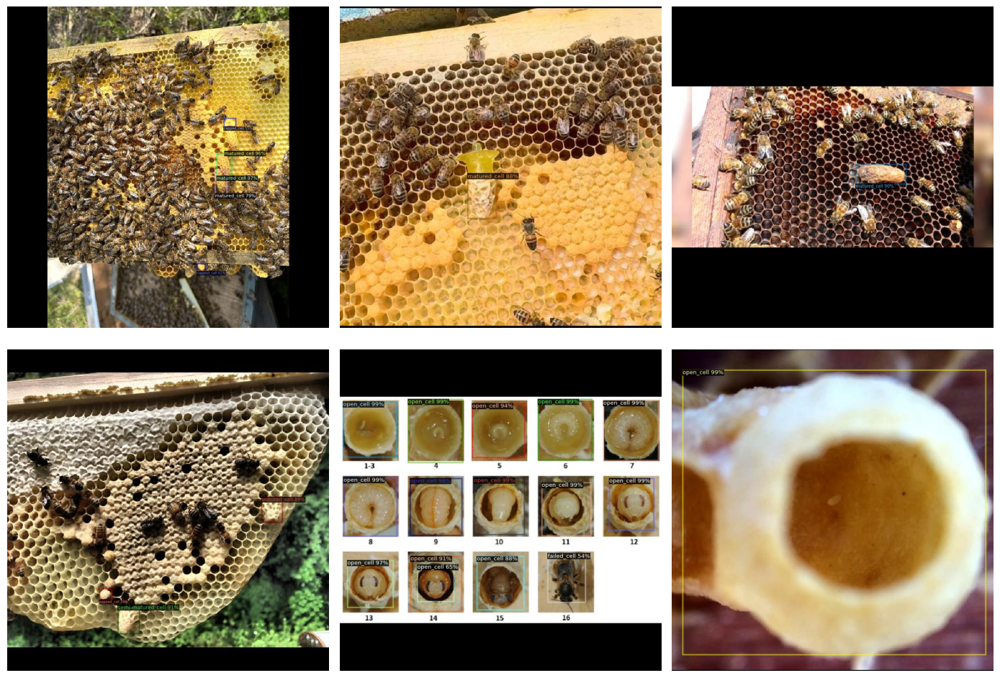

In [ ]:
from detectron2.utils.visualizer import Visualizer, ColorMode
from detectron2.data import MetadataCatalog
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.data.datasets import register_coco_instances
from detectron2.data import DatasetCatalog

import cv2, os, glob, random
import matplotlib.pyplot as plt
import shutil

cfg_faster_rcnn = get_cfg()
cfg_faster_rcnn.merge_from_file("/content/detectron2/configs/COCO-Detection/faster_rcnn_R_50_FPN_3x.yaml")
cfg_faster_rcnn.MODEL.WEIGHTS = "/content/queen_output_faster/model_final.pth"
cfg_faster_rcnn.MODEL.ROI_HEADS.NUM_CLASSES = 5
cfg_faster_rcnn.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5

predictor_faster_rcnn = DefaultPredictor(cfg_faster_rcnn)

FASTER_RCNN_CLASSES = ["capped_cell", "failed_cell", "matured_cell", "open_cell", "semi-matured_cell"]

root_test = "/content/detectron2/queen-cells-segment-1/test"
test_dataset_name = "queen_test"

if test_dataset_name in DatasetCatalog.keys():
    DatasetCatalog.remove(test_dataset_name)
if test_dataset_name in MetadataCatalog.keys():
    MetadataCatalog.remove(test_dataset_name)

register_coco_instances(
    test_dataset_name,
    {"thing_classes": FASTER_RCNN_CLASSES},
    f"{root_test}/_annotations.coco_clean.json",
    root_test
)

meta_faster_rcnn_test = MetadataCatalog.get(test_dataset_name)

output_dir_test = "/content/visualized_output_faster_rcnn_test"
if os.path.exists(output_dir_test):
    shutil.rmtree(output_dir_test)
os.makedirs(output_dir_test, exist_ok=True)

img_list = glob.glob(f"{root_test}/*")
sample_imgs = random.sample(img_list, min(6, len(img_list)))

for image_path in sample_imgs:
    im = cv2.imread(image_path)
    if im is None:
        print("Cannot read:", image_path)
        continue

    outputs = predictor_faster_rcnn(im)
    instances = outputs["instances"].to("cpu")
    if instances.has("scores"):
        keep = instances.scores > cfg_faster_rcnn.MODEL.ROI_HEADS.SCORE_THRESH_TEST
        instances = instances[keep]

    v = Visualizer(
        im[:, :, ::-1],
        metadata=meta_faster_rcnn_test,
        scale=1.2,
        instance_mode=ColorMode.IMAGE
    )
    out = v.draw_instance_predictions(instances)

    save_path = os.path.join(output_dir_test, os.path.basename(image_path))
    cv2.imwrite(save_path, out.get_image()[:, :, ::-1])

print("Test images visualized and saved in:", output_dir_test)

results_test = glob.glob(f"{output_dir_test}/*")
if results_test:
    plt.figure(figsize=(14, 10))
    samples_test = random.sample(results_test, min(6, len(results_test)))
    for i, img_path in enumerate(samples_test):
        plt.subplot(2, 3, i+1)
        img = cv2.imread(img_path)
        plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
        plt.axis("off")
    plt.tight_layout()
    plt.show()
else:
    print("No visualized test images found. Please run the inference step first.")


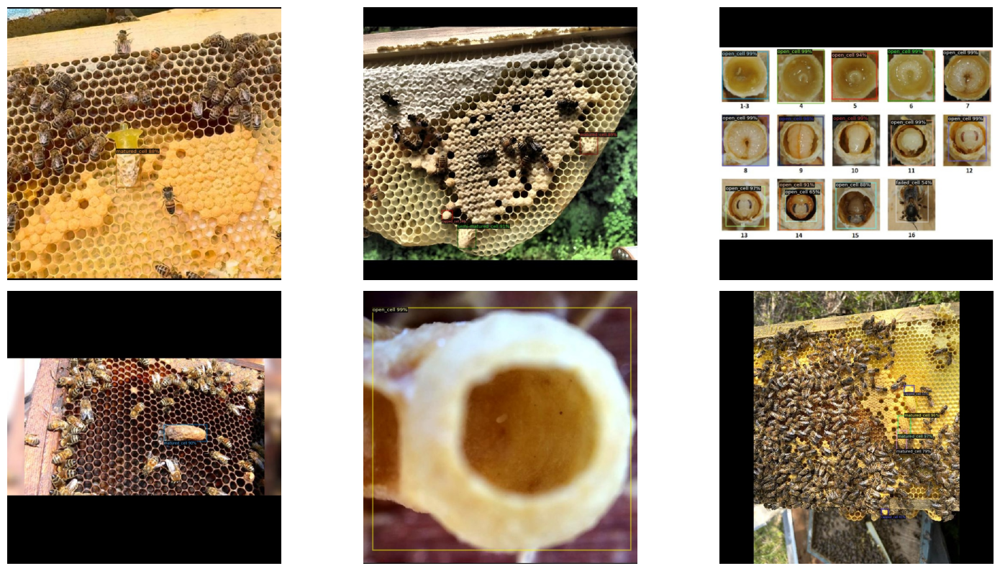

In [ ]:
results_test = glob.glob(f"{output_dir_test}/*")
if results_test:
    plt.figure(figsize=(15, 12))  # bigger figure for 9 images
    num_samples = min(9, len(results_test))
    samples_test = random.sample(results_test, num_samples)

    for i, img_path in enumerate(samples_test):
        plt.subplot(3, 3, i+1)  # 3x3 grid
        img = cv2.imread(img_path)
        plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
        plt.axis("off")

    plt.tight_layout()
    plt.show()
else:
    print("No visualized test images found. Please run the inference step first.")


[11/04 13:31:27 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from /content/queen_output_faster/model_final.pth ...
Test images visualized and saved in: /content/visualized_output_faster_rcnn_test


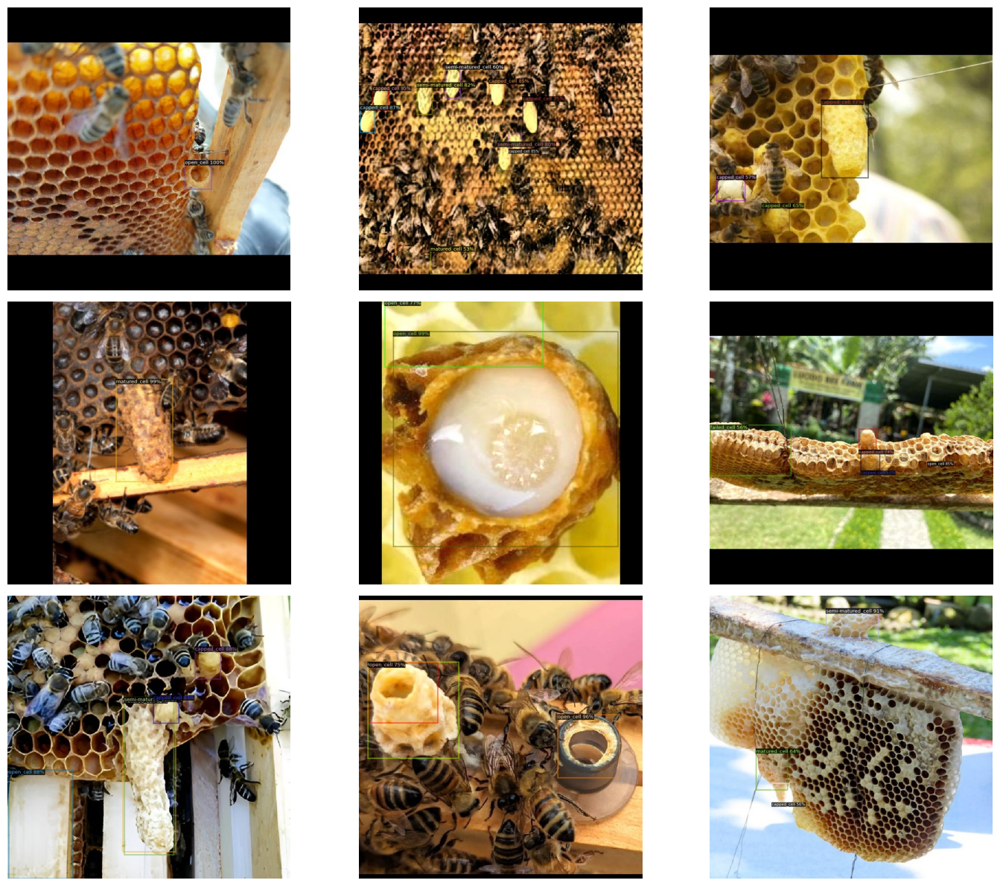

In [ ]:
from detectron2.utils.visualizer import Visualizer, ColorMode
from detectron2.data import MetadataCatalog
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.data.datasets import register_coco_instances
from detectron2.data import DatasetCatalog

import cv2, os, glob, random, shutil
import matplotlib.pyplot as plt

cfg_faster_rcnn = get_cfg()
cfg_faster_rcnn.merge_from_file("/content/detectron2/configs/COCO-Detection/faster_rcnn_R_50_FPN_3x.yaml")
cfg_faster_rcnn.MODEL.WEIGHTS = "/content/queen_output_faster/model_final.pth"
cfg_faster_rcnn.MODEL.ROI_HEADS.NUM_CLASSES = 5
cfg_faster_rcnn.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5

predictor_faster_rcnn = DefaultPredictor(cfg_faster_rcnn)

FASTER_RCNN_CLASSES = ["capped_cell", "failed_cell", "matured_cell", "open_cell", "semi-matured_cell"]

root_test = "/content/detectron2/queen-cells-segment-1/test"
test_dataset_name = "queen_test"

if test_dataset_name in DatasetCatalog.keys():
    DatasetCatalog.remove(test_dataset_name)
if test_dataset_name in MetadataCatalog.keys():
    MetadataCatalog.remove(test_dataset_name)

register_coco_instances(
    test_dataset_name,
    {"thing_classes": FASTER_RCNN_CLASSES},
    f"{root_test}/_annotations.coco_clean.json",
    root_test
)

meta_faster_rcnn_test = MetadataCatalog.get(test_dataset_name)

output_dir_test = "/content/visualized_output_faster_rcnn_test"
if os.path.exists(output_dir_test):
    shutil.rmtree(output_dir_test)
os.makedirs(output_dir_test, exist_ok=True)

img_list = [p for p in glob.glob(f"{root_test}/*") if p.lower().endswith(('.jpg', '.jpeg', '.png'))]
if len(img_list) == 0:
    raise ValueError(f"No images found in {root_test} — check image folder path.")

sample_imgs = random.sample(img_list, min(9, len(img_list)))

for image_path in sample_imgs:
    im = cv2.imread(image_path)
    if im is None:
        print("Cannot read:", image_path)
        continue

    outputs = predictor_faster_rcnn(im)
    instances = outputs["instances"].to("cpu")

    if instances.has("scores"):
        keep_mask = instances.scores > cfg_faster_rcnn.MODEL.ROI_HEADS.SCORE_THRESH_TEST
        instances = instances[keep_mask]

    v = Visualizer(
        im[:, :, ::-1],
        metadata=meta_faster_rcnn_test,
        scale=1.2,
        instance_mode=ColorMode.IMAGE
    )
    out = v.draw_instance_predictions(instances)

    save_path = os.path.join(output_dir_test, os.path.basename(image_path))
    cv2.imwrite(save_path, out.get_image()[:, :, ::-1])

print("Test images visualized and saved in:", output_dir_test)

results_test = [p for p in glob.glob(f"{output_dir_test}/*") if p.lower().endswith(('.jpg', '.jpeg', '.png'))]
if results_test:
    plt.figure(figsize=(15, 12))
    samples_test = random.sample(results_test, min(9, len(results_test)))  # up to 9
    for i, img_path in enumerate(samples_test):
        plt.subplot(3, 3, i+1)
        img = cv2.imread(img_path)
        if img is None:
            print("Cannot load:", img_path)
            continue
        plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
        plt.axis("off")
    plt.tight_layout()
    plt.show()
else:
    print("No visualized test images found. Please run the inference step first.")


[11/04 13:33:43 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from /content/queen_output_faster/model_final.pth ...
Test images visualized and saved in: /content/visualized_output_faster_rcnn_test


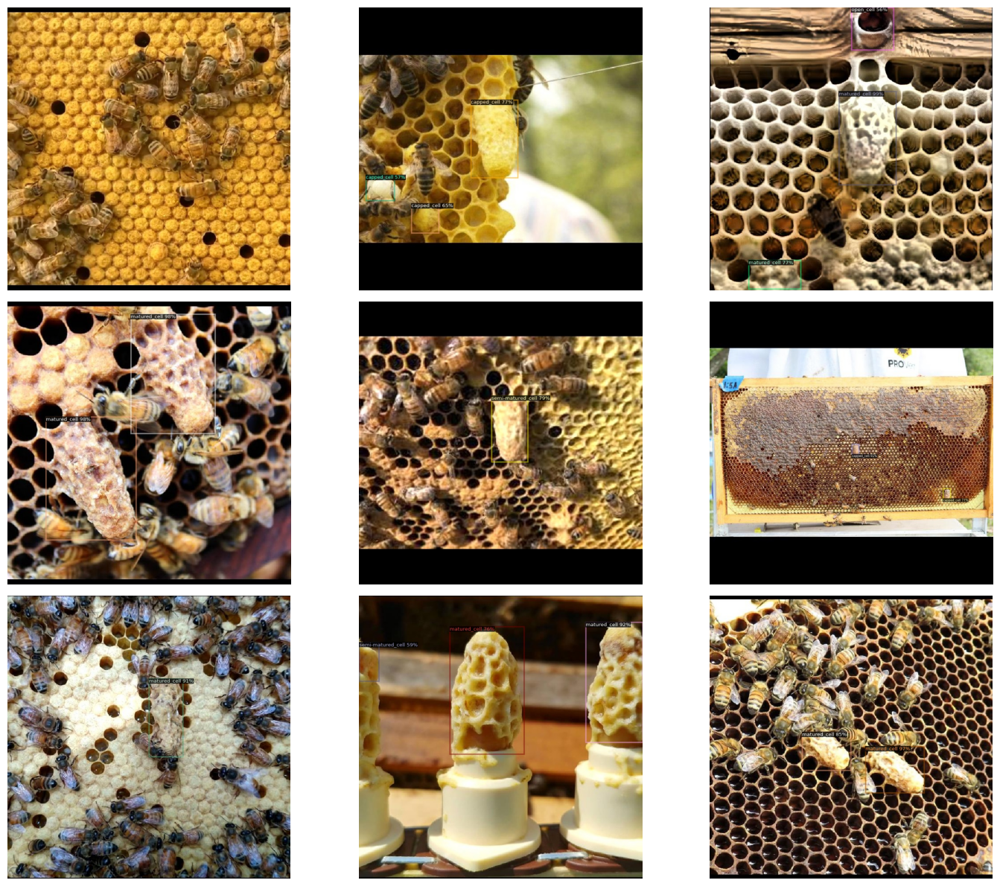

In [ ]:
from detectron2.utils.visualizer import Visualizer, ColorMode
from detectron2.data import MetadataCatalog
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.data.datasets import register_coco_instances
from detectron2.data import DatasetCatalog

import cv2, os, glob, random, shutil
import matplotlib.pyplot as plt

cfg_faster_rcnn = get_cfg()
cfg_faster_rcnn.merge_from_file("/content/detectron2/configs/COCO-Detection/faster_rcnn_R_50_FPN_3x.yaml")
cfg_faster_rcnn.MODEL.WEIGHTS = "/content/queen_output_faster/model_final.pth"
cfg_faster_rcnn.MODEL.ROI_HEADS.NUM_CLASSES = 5
cfg_faster_rcnn.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5

predictor_faster_rcnn = DefaultPredictor(cfg_faster_rcnn)

FASTER_RCNN_CLASSES = ["capped_cell", "failed_cell", "matured_cell", "open_cell", "semi-matured_cell"]

root_test = "/content/detectron2/queen-cells-segment-1/test"
test_dataset_name = "queen_test"

if test_dataset_name in DatasetCatalog.keys():
    DatasetCatalog.remove(test_dataset_name)
if test_dataset_name in MetadataCatalog.keys():
    MetadataCatalog.remove(test_dataset_name)

register_coco_instances(
    test_dataset_name,
    {"thing_classes": FASTER_RCNN_CLASSES},
    f"{root_test}/_annotations.coco_clean.json",
    root_test
)

meta_faster_rcnn_test = MetadataCatalog.get(test_dataset_name)

output_dir_test = "/content/visualized_output_faster_rcnn_test"
if os.path.exists(output_dir_test):
    shutil.rmtree(output_dir_test)
os.makedirs(output_dir_test, exist_ok=True)

img_list = [p for p in glob.glob(f"{root_test}/*") if p.lower().endswith(('.jpg', '.jpeg', '.png'))]
if len(img_list) == 0:
    raise ValueError(f"No images found in {root_test} — check image folder path.")

sample_imgs = random.sample(img_list, min(9, len(img_list)))

for image_path in sample_imgs:
    im = cv2.imread(image_path)
    if im is None:
        print("Cannot read:", image_path)
        continue

    outputs = predictor_faster_rcnn(im)
    instances = outputs["instances"].to("cpu")

    if instances.has("scores"):
        keep_mask = instances.scores > cfg_faster_rcnn.MODEL.ROI_HEADS.SCORE_THRESH_TEST
        instances = instances[keep_mask]

    v = Visualizer(
        im[:, :, ::-1],
        metadata=meta_faster_rcnn_test,
        scale=1.2,
        instance_mode=ColorMode.IMAGE
    )
    out = v.draw_instance_predictions(instances)

    save_path = os.path.join(output_dir_test, os.path.basename(image_path))
    cv2.imwrite(save_path, out.get_image()[:, :, ::-1])

print("Test images visualized and saved in:", output_dir_test)

results_test = [p for p in glob.glob(f"{output_dir_test}/*") if p.lower().endswith(('.jpg', '.jpeg', '.png'))]
if results_test:
    plt.figure(figsize=(15, 12))
    samples_test = random.sample(results_test, min(9, len(results_test)))  # up to 9
    for i, img_path in enumerate(samples_test):
        plt.subplot(3, 3, i+1)
        img = cv2.imread(img_path)
        if img is None:
            print("Cannot load:", img_path)
            continue
        plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
        plt.axis("off")
    plt.tight_layout()
    plt.show()
else:
    print("No visualized test images found. Please run the inference step first.")


# Graphs

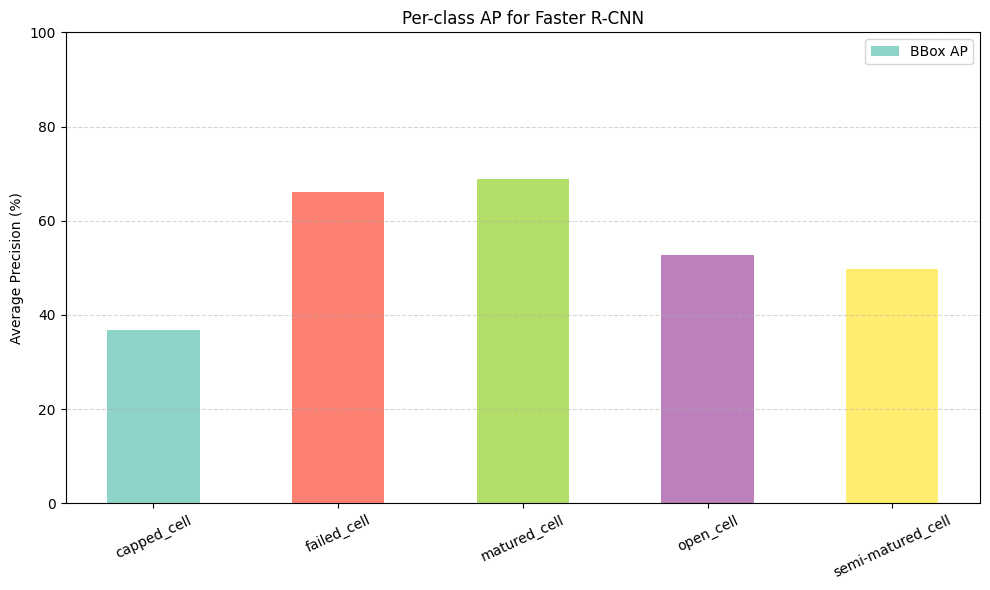

In [ ]:
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import numpy as np

classes = ['capped_cell', 'failed_cell', 'matured_cell', 'open_cell', 'semi-matured_cell']
bbox_ap = [36.821, 66.107, 68.779, 52.676, 49.661]

x = np.arange(len(classes))
colors = plt.cm.Set3(np.linspace(0, 1, len(classes)))

plt.figure(figsize=(10,6))
plt.bar(x, bbox_ap, width=0.5, color=colors, label='BBox AP')

plt.xticks(x, classes, rotation=25)
plt.ylabel("Average Precision (%)")
plt.title("Per-class AP for Faster R-CNN")
plt.ylim(0, 100)
plt.legend()
plt.grid(axis='y', linestyle='--', alpha=0.5)
plt.tight_layout()
plt.show()


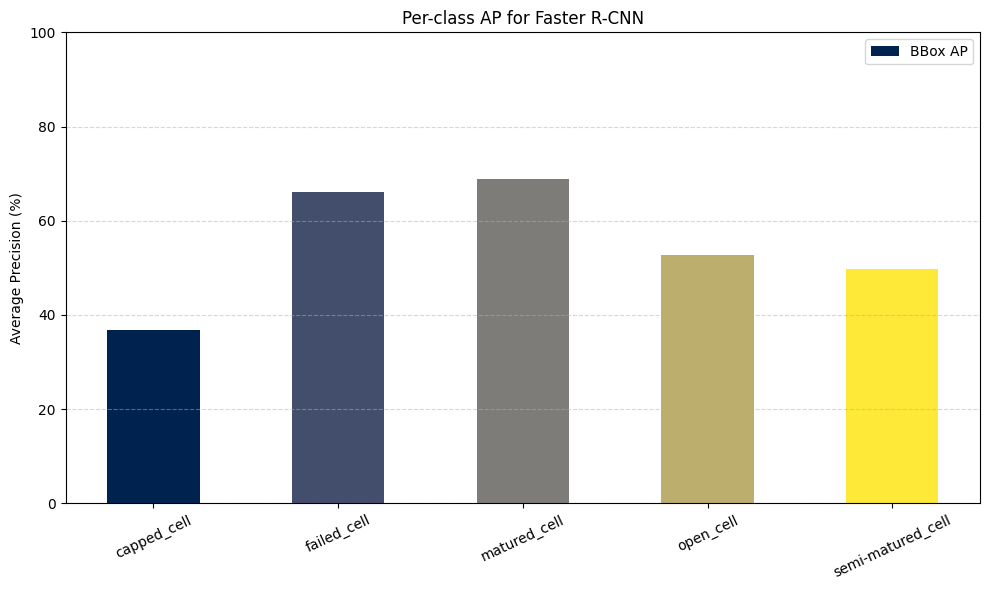

In [ ]:
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import numpy as np

classes = ['capped_cell', 'failed_cell', 'matured_cell', 'open_cell', 'semi-matured_cell']
bbox_ap = [36.821, 66.107, 68.779, 52.676, 49.661]

x = np.arange(len(classes))
colors = plt.cm.cividis(np.linspace(0, 1, len(classes)))

plt.figure(figsize=(10,6))
plt.bar(x, bbox_ap, width=0.5, color=colors, label='BBox AP')

plt.xticks(x, classes, rotation=25)
plt.ylabel("Average Precision (%)")
plt.title("Per-class AP for Faster R-CNN")
plt.ylim(0, 100)
plt.legend()
plt.grid(axis='y', linestyle='--', alpha=0.5)
plt.tight_layout()
plt.show()


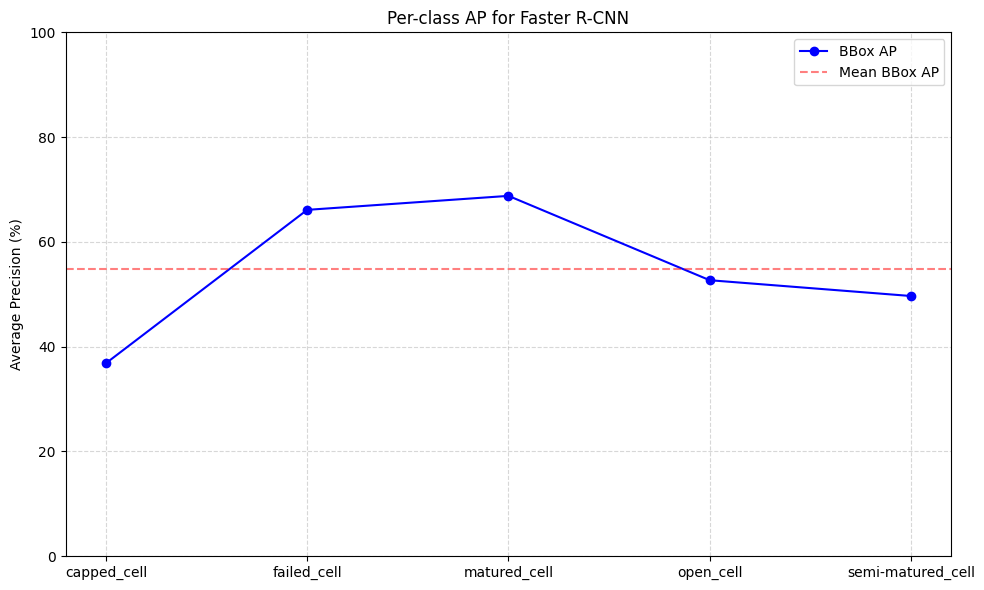

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

classes = ['capped_cell', 'failed_cell', 'matured_cell', 'open_cell', 'semi-matured_cell']
bbox_ap = [36.821, 66.107, 68.779, 52.676, 49.661]

plt.figure(figsize=(10,6))
plt.plot(classes, bbox_ap, marker='o', label='BBox AP', color='blue')
plt.axhline(np.mean(bbox_ap), color='red', linestyle='--', alpha=0.5, label='Mean BBox AP')

plt.ylabel("Average Precision (%)")
plt.title("Per-class AP for Faster R-CNN")
plt.ylim(0, 100)
plt.grid(linestyle='--', alpha=0.5)
plt.legend()
plt.tight_layout()
plt.show()


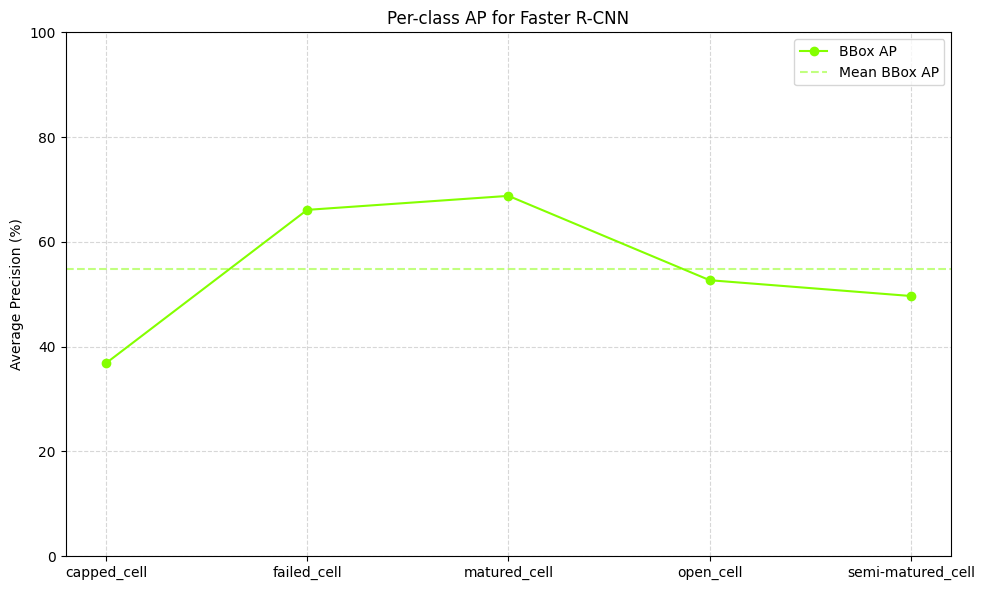

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

classes = ['capped_cell', 'failed_cell', 'matured_cell', 'open_cell', 'semi-matured_cell']
bbox_ap = [36.821, 66.107, 68.779, 52.676, 49.661]

cmap = plt.cm.hsv
color1 = cmap(0.25)
plt.figure(figsize=(10,6))
plt.plot(classes, bbox_ap, marker='o', label='BBox AP', color=color1)
plt.axhline(np.mean(bbox_ap), color=color1, linestyle='--', alpha=0.5, label='Mean BBox AP')

plt.ylabel("Average Precision (%)")
plt.title("Per-class AP for Faster R-CNN")
plt.ylim(0, 100)
plt.grid(linestyle='--', alpha=0.5)
plt.legend()
plt.tight_layout()
plt.show()


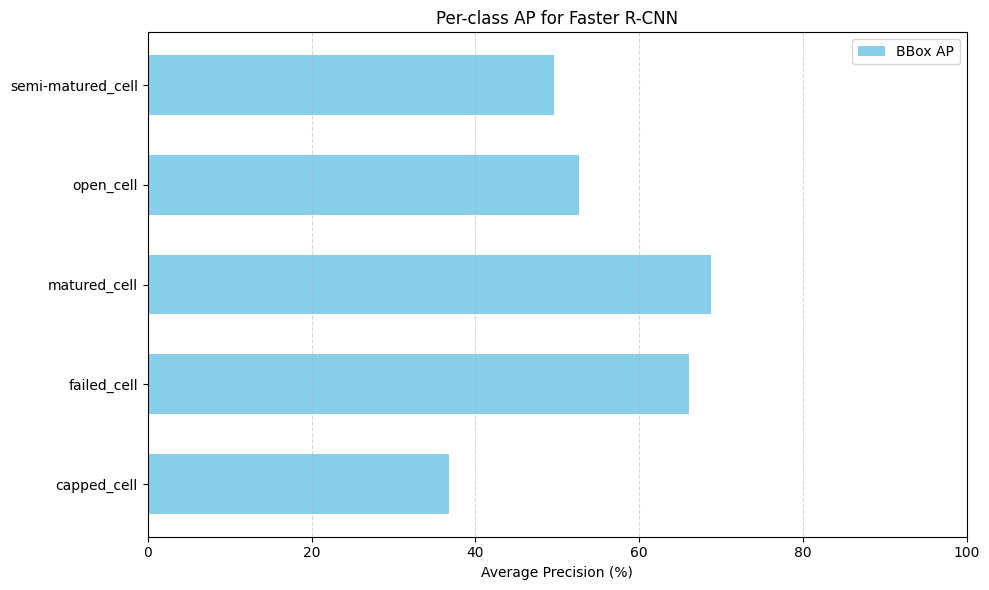

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

classes = ['capped_cell', 'failed_cell', 'matured_cell', 'open_cell', 'semi-matured_cell']
bbox_ap_faster = [36.821, 66.107, 68.779, 52.676, 49.661]

y = np.arange(len(classes))

plt.figure(figsize=(10,6))
plt.barh(y, bbox_ap_faster, height=0.6, label='BBox AP', color='skyblue')
plt.yticks(y, classes)
plt.xlabel("Average Precision (%)")
plt.title("Per-class AP for Faster R-CNN")
plt.xlim(0, 100)
plt.legend()
plt.grid(axis='x', linestyle='--', alpha=0.5)
plt.tight_layout()
plt.show()


The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.


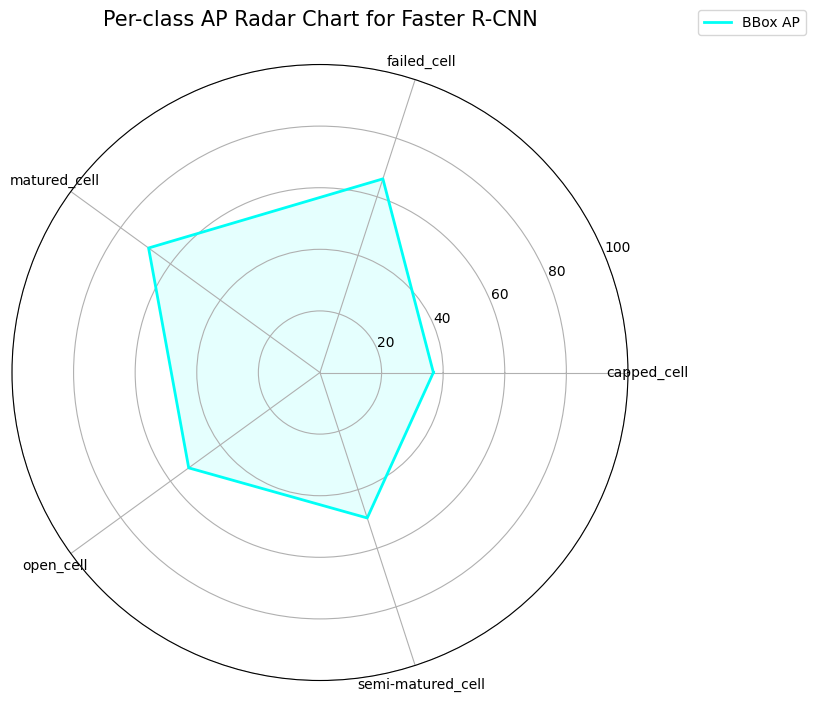

In [ ]:
from math import pi
import matplotlib.pyplot as plt
import matplotlib as mpl

cmap = mpl.cm.get_cmap("hsv")
c1 = cmap(0.5)

categories = ['capped_cell', 'failed_cell', 'matured_cell', 'open_cell', 'semi-matured_cell']
N = len(categories)
bbox_values = [36.821, 66.107, 68.779, 52.676, 49.661]

angles = [n / float(N) * 2 * pi for n in range(N)]
angles += angles[:1]
bbox_values += bbox_values[:1]

plt.figure(figsize=(8,8))
ax = plt.subplot(111, polar=True)

ax.plot(angles, bbox_values, linewidth=2, linestyle='solid', label="BBox AP", color=c1)
ax.fill(angles, bbox_values, color=c1, alpha=0.1)

ax.set_xticks(angles[:-1])
ax.set_xticklabels(categories)
ax.set_yticks([20, 40, 60, 80, 100])
ax.set_yticklabels(['20', '40', '60', '80', '100'])

plt.title("Per-class AP Radar Chart for Faster R-CNN", size=15, y=1.05)
plt.legend(loc='upper right', bbox_to_anchor=(1.3, 1.1))
plt.show()


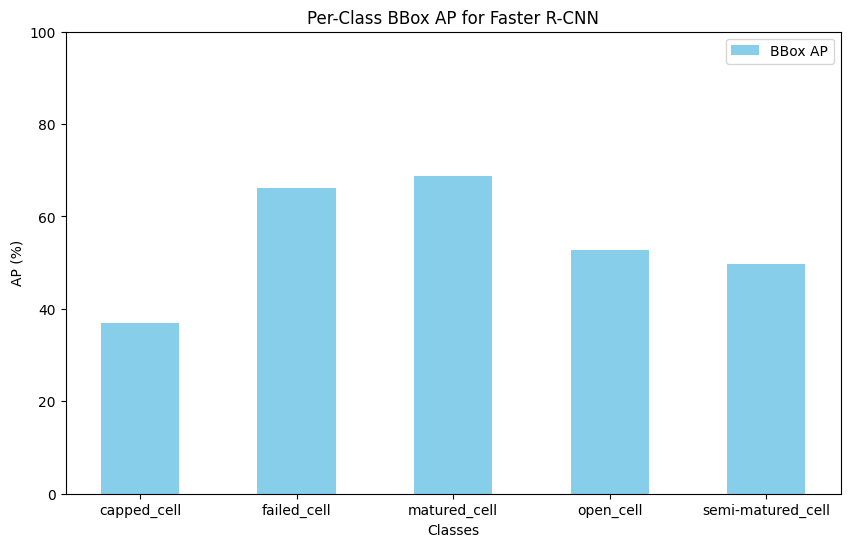

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

classes = ["capped_cell", "failed_cell", "matured_cell", "open_cell", "semi-matured_cell"]
bbox_ap = [36.821, 66.107, 68.779, 52.676, 49.661]

x = np.arange(len(classes))
width = 0.5

fig, ax = plt.subplots(figsize=(10,6))
ax.bar(x, bbox_ap, width, label='BBox AP', color='skyblue')

ax.set_xlabel('Classes')
ax.set_ylabel('AP (%)')
ax.set_title('Per-Class BBox AP for Faster R-CNN')
ax.set_xticks(x)
ax.set_xticklabels(classes)
ax.set_ylim(0, 100)
ax.legend()
plt.show()


# Faster RCNN vs. Mask RCNN

The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.


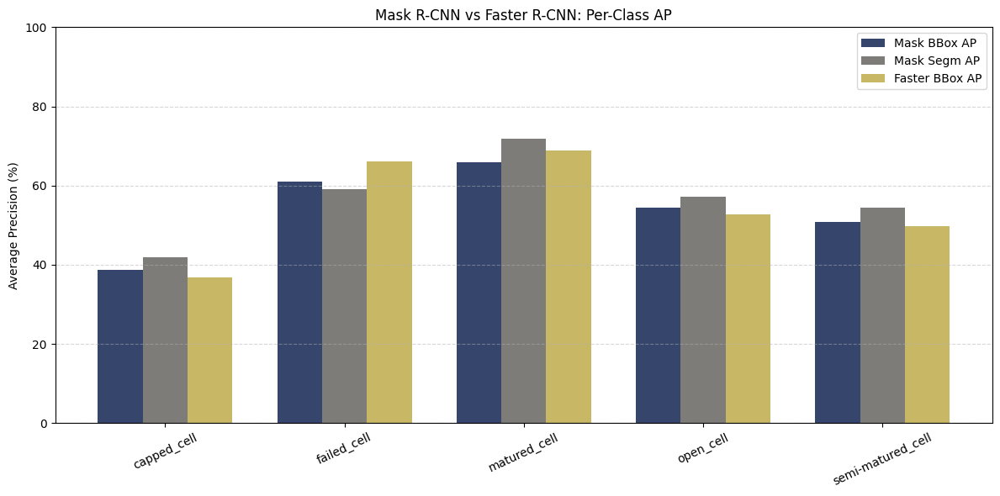

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import matplotlib as mpl

classes = ["capped_cell", "failed_cell", "matured_cell", "open_cell", "semi-matured_cell"]
mask_bbox_ap = [38.74, 61.07, 65.98, 54.33, 50.77]
mask_segm_ap = [41.99, 59.16, 71.92, 57.22, 54.47]
faster_bbox_ap = [36.82, 66.11, 68.78, 52.68, 49.66]

x = np.arange(len(classes))
width = 0.25

cmap = mpl.cm.get_cmap("cividis")
c_mask_bbox = cmap(0.2)
c_mask_segm = cmap(0.5)
c_faster_bbox = cmap(0.8)

fig, ax = plt.subplots(figsize=(12,6))
ax.bar(x - width, mask_bbox_ap, width, label='Mask BBox AP', color=c_mask_bbox)
ax.bar(x, mask_segm_ap, width, label='Mask Segm AP', color=c_mask_segm)
ax.bar(x + width, faster_bbox_ap, width, label='Faster BBox AP', color=c_faster_bbox)

ax.set_xticks(x)
ax.set_xticklabels(classes, rotation=25)
ax.set_ylabel("Average Precision (%)")
ax.set_title("Mask R-CNN vs Faster R-CNN: Per-Class AP")
ax.set_ylim(0, 100)
ax.legend()
plt.grid(axis='y', linestyle='--', alpha=0.5)
plt.tight_layout()
plt.show()


The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.


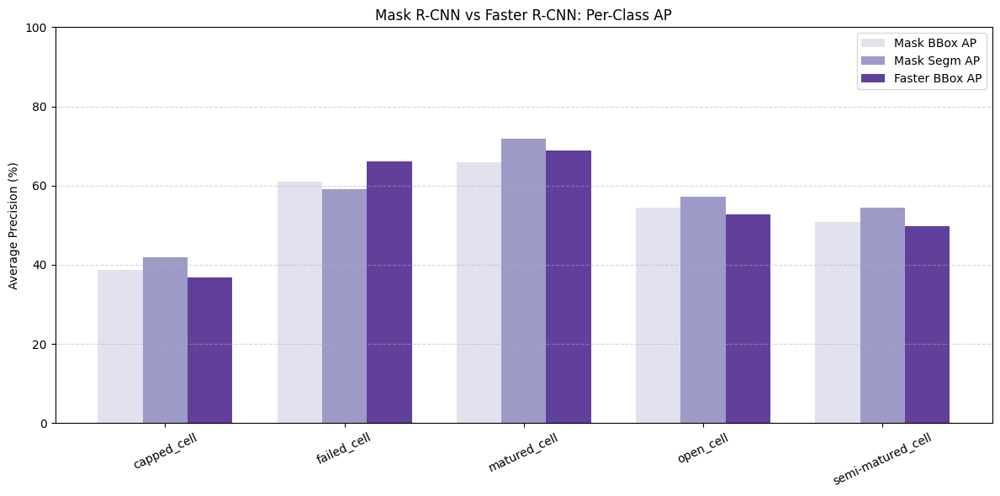

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import matplotlib as mpl

classes = ["capped_cell", "failed_cell", "matured_cell", "open_cell", "semi-matured_cell"]
mask_bbox_ap = [38.74, 61.07, 65.98, 54.33, 50.77]
mask_segm_ap = [41.99, 59.16, 71.92, 57.22, 54.47]
faster_bbox_ap = [36.82, 66.11, 68.78, 52.68, 49.66]

x = np.arange(len(classes))
width = 0.25

cmap = mpl.cm.get_cmap("Purples")
c_mask_bbox = cmap(0.2)
c_mask_segm = cmap(0.5)
c_faster_bbox = cmap(0.8)

fig, ax = plt.subplots(figsize=(12,6))
ax.bar(x - width, mask_bbox_ap, width, label='Mask BBox AP', color=c_mask_bbox)
ax.bar(x, mask_segm_ap, width, label='Mask Segm AP', color=c_mask_segm)
ax.bar(x + width, faster_bbox_ap, width, label='Faster BBox AP', color=c_faster_bbox)

ax.set_xticks(x)
ax.set_xticklabels(classes, rotation=25)
ax.set_ylabel("Average Precision (%)")
ax.set_title("Mask R-CNN vs Faster R-CNN: Per-Class AP")
ax.set_ylim(0, 100)
ax.legend()
plt.grid(axis='y', linestyle='--', alpha=0.5)
plt.tight_layout()
plt.show()


The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.


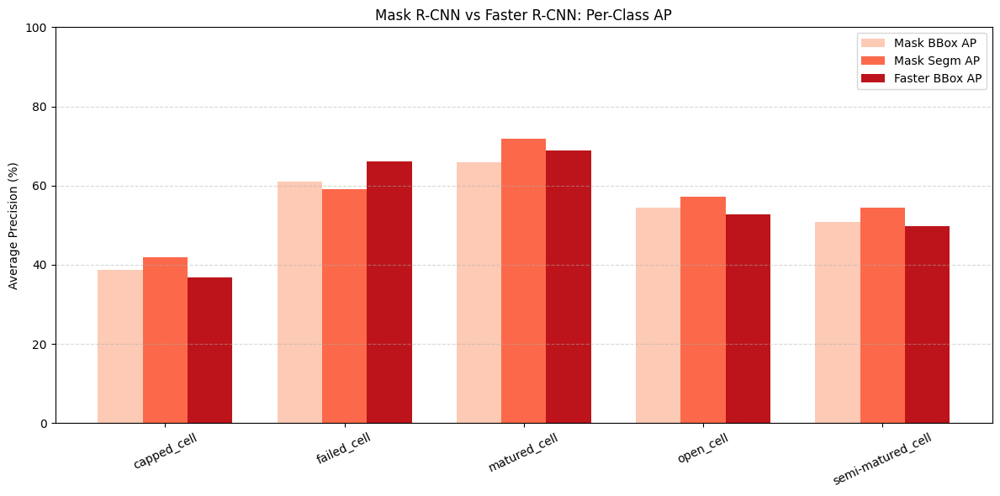

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import matplotlib as mpl

classes = ["capped_cell", "failed_cell", "matured_cell", "open_cell", "semi-matured_cell"]
mask_bbox_ap = [38.74, 61.07, 65.98, 54.33, 50.77]
mask_segm_ap = [41.99, 59.16, 71.92, 57.22, 54.47]
faster_bbox_ap = [36.82, 66.11, 68.78, 52.68, 49.66]

x = np.arange(len(classes))
width = 0.25

cmap = mpl.cm.get_cmap("Reds")
c_mask_bbox = cmap(0.2)
c_mask_segm = cmap(0.5)
c_faster_bbox = cmap(0.8)

fig, ax = plt.subplots(figsize=(12,6))
ax.bar(x - width, mask_bbox_ap, width, label='Mask BBox AP', color=c_mask_bbox)
ax.bar(x, mask_segm_ap, width, label='Mask Segm AP', color=c_mask_segm)
ax.bar(x + width, faster_bbox_ap, width, label='Faster BBox AP', color=c_faster_bbox)

ax.set_xticks(x)
ax.set_xticklabels(classes, rotation=25)
ax.set_ylabel("Average Precision (%)")
ax.set_title("Mask R-CNN vs Faster R-CNN: Per-Class AP")
ax.set_ylim(0, 100)
ax.legend()
plt.grid(axis='y', linestyle='--', alpha=0.5)
plt.tight_layout()
plt.show()


The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.


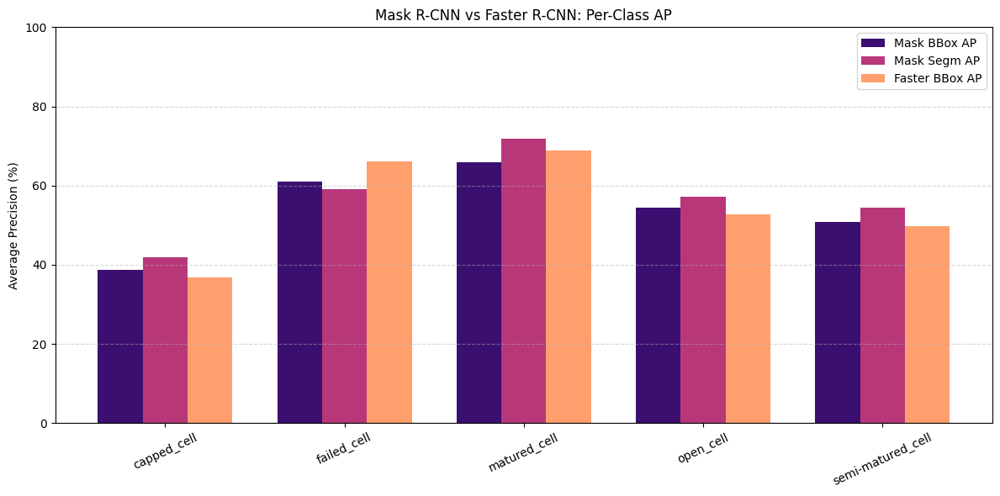

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import matplotlib as mpl

classes = ["capped_cell", "failed_cell", "matured_cell", "open_cell", "semi-matured_cell"]
mask_bbox_ap = [38.74, 61.07, 65.98, 54.33, 50.77]
mask_segm_ap = [41.99, 59.16, 71.92, 57.22, 54.47]
faster_bbox_ap = [36.82, 66.11, 68.78, 52.68, 49.66]

x = np.arange(len(classes))
width = 0.25

cmap = mpl.cm.get_cmap("magma")
c_mask_bbox = cmap(0.2)
c_mask_segm = cmap(0.5)
c_faster_bbox = cmap(0.8)

fig, ax = plt.subplots(figsize=(12,6))
ax.bar(x - width, mask_bbox_ap, width, label='Mask BBox AP', color=c_mask_bbox)
ax.bar(x, mask_segm_ap, width, label='Mask Segm AP', color=c_mask_segm)
ax.bar(x + width, faster_bbox_ap, width, label='Faster BBox AP', color=c_faster_bbox)

ax.set_xticks(x)
ax.set_xticklabels(classes, rotation=25)
ax.set_ylabel("Average Precision (%)")
ax.set_title("Mask R-CNN vs Faster R-CNN: Per-Class AP")
ax.set_ylim(0, 100)
ax.legend()
plt.grid(axis='y', linestyle='--', alpha=0.5)
plt.tight_layout()
plt.show()


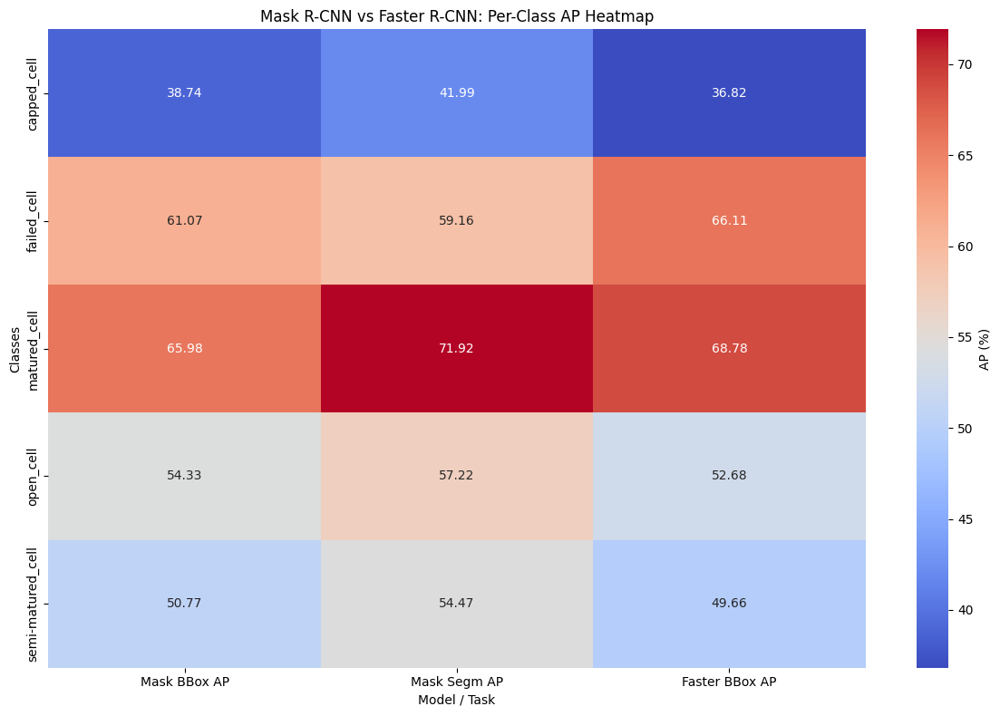

In [ ]:
import seaborn as sns
import pandas as pd

data = {
    "Mask BBox AP": mask_bbox_ap,
    "Mask Segm AP": mask_segm_ap,
    "Faster BBox AP": faster_bbox_ap
}

df = pd.DataFrame(data, index=classes)

plt.figure(figsize=(12, 8))
sns.heatmap(df, annot=True, fmt=".2f", cmap="coolwarm", cbar_kws={'label': 'AP (%)'})
plt.title("Mask R-CNN vs Faster R-CNN: Per-Class AP Heatmap")
plt.ylabel("Classes")
plt.xlabel("Model / Task")
plt.tight_layout()
plt.show()


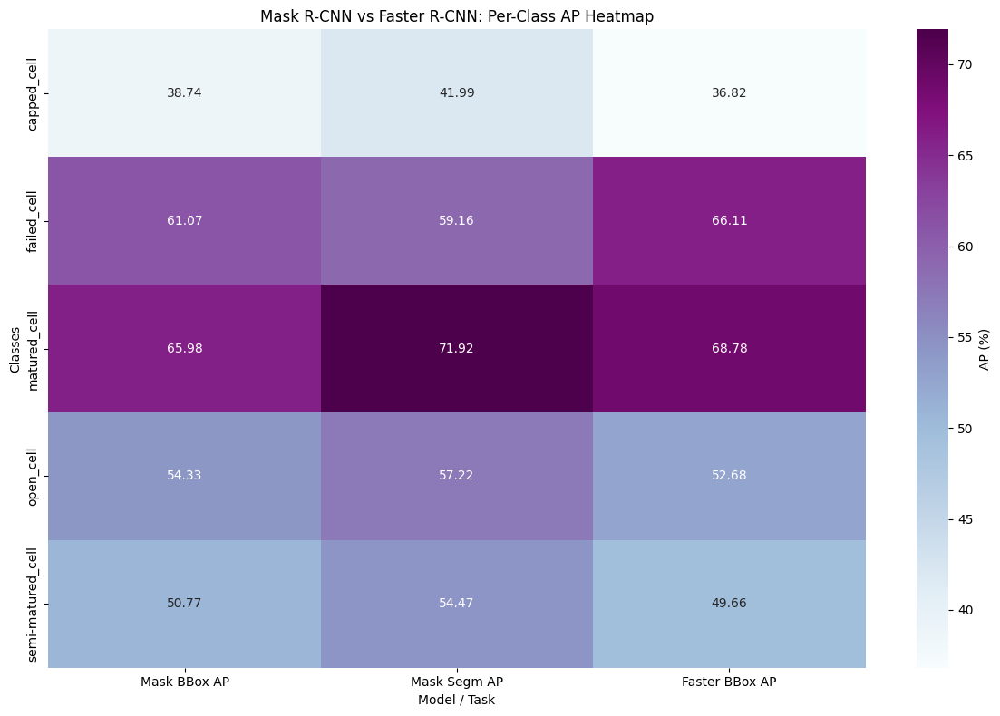

In [ ]:
import seaborn as sns
import pandas as pd

data = {
    "Mask BBox AP": mask_bbox_ap,
    "Mask Segm AP": mask_segm_ap,
    "Faster BBox AP": faster_bbox_ap
}

df = pd.DataFrame(data, index=classes)

plt.figure(figsize=(12, 8))
sns.heatmap(df, annot=True, fmt=".2f", cmap="BuPu", cbar_kws={'label': 'AP (%)'})
plt.title("Mask R-CNN vs Faster R-CNN: Per-Class AP Heatmap")
plt.ylabel("Classes")
plt.xlabel("Model / Task")
plt.tight_layout()
plt.show()


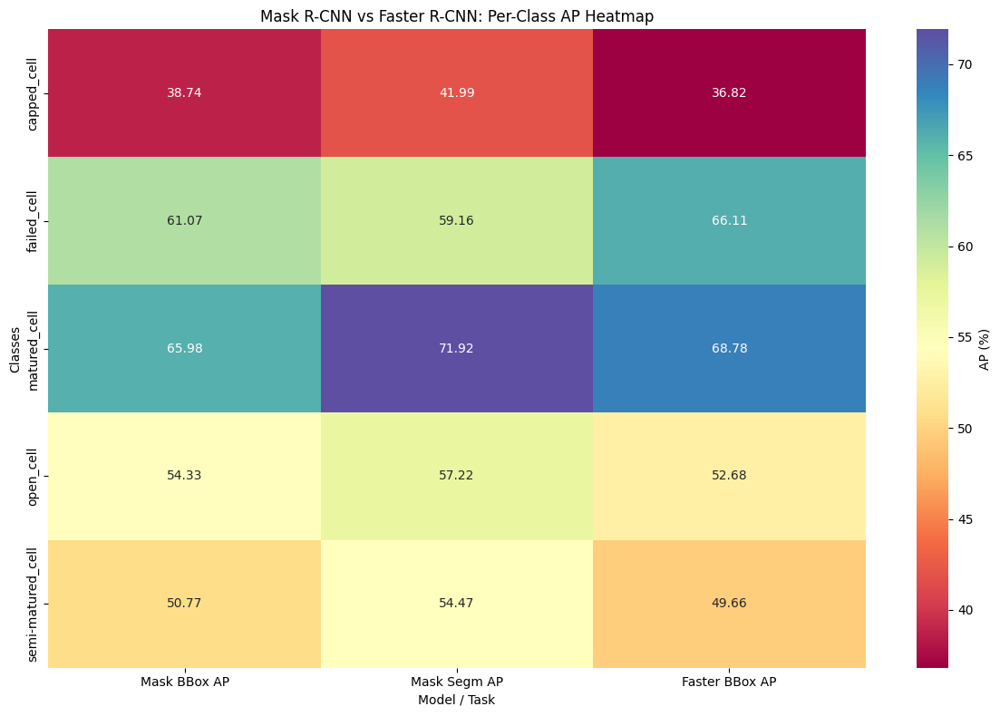

In [ ]:
import seaborn as sns
import pandas as pd

data = {
    "Mask BBox AP": mask_bbox_ap,
    "Mask Segm AP": mask_segm_ap,
    "Faster BBox AP": faster_bbox_ap
}

df = pd.DataFrame(data, index=classes)

plt.figure(figsize=(12, 8))
sns.heatmap(df, annot=True, fmt=".2f", cmap="Spectral", cbar_kws={'label': 'AP (%)'})
plt.title("Mask R-CNN vs Faster R-CNN: Per-Class AP Heatmap")
plt.ylabel("Classes")
plt.xlabel("Model / Task")
plt.tight_layout()
plt.show()


In [ ]:
import seaborn as sns
import pandas as pd

data = {
    "Mask BBox AP": mask_bbox_ap,
    "Mask Segm AP": mask_segm_ap,
    "Faster BBox AP": faster_bbox_ap
}

df = pd.DataFrame(data, index=classes)

plt.figure(figsize=(12, 8))
sns.heatmap(df, annot=True, fmt=".2f", cmap="PuOr", cbar_kws={'label': 'AP (%)'})
plt.title("Mask R-CNN vs Faster R-CNN: Per-Class AP Heatmap")
plt.ylabel("Classes")
plt.xlabel("Model / Task")
plt.tight_layout()
plt.show()




### Interpretation of Faster R-CNN Results

* **Overall Performance**

  * The **mean Average Precision (mAP)** across all classes is approximately **54.81%**, which indicates moderate detection accuracy.
  * **AP50** is **75.06%**, showing that the model performs reasonably well at the IoU threshold of 0.5.
  * **AP75** is **66.39%**, suggesting that the model is less precise at stricter overlap thresholds.

* **Per-Class Performance**

  | Class             | AP (%) |
  | ----------------- | ------ |
  | Capped Cell       | 36.82  |
  | Failed Cell       | 66.11  |
  | Matured Cell      | 68.78  |
  | Open Cell         | 52.68  |
  | Semi-Matured Cell | 49.66  |

  * **Best performing classes**:

    * *Matured Cell* (**68.78%**) and *Failed Cell* (**66.11%**) are detected most accurately.
  * **Worst performing class**:

    * *Capped Cell* (**36.82%**) has the lowest AP, indicating the model struggles to detect these reliably.
  * Other classes (*Open Cell*, *Semi-Matured Cell*) have moderate detection accuracy (**50–53%**).

* **Size-based Performance**

  * **Small objects**: AP = 34.77% → smaller cells are challenging for the model.
  * **Medium objects**: AP = 60.73% → model performs better on medium-sized cells.
  * **Large objects**: AP = 51.68% → slightly lower than medium, but better than small objects.

* **Recall**

  * Average Recall for all detections (maxDets=100) is **73.4%**, showing the model can detect most objects, but not always precisely.

**Summary:**

* Faster R-CNN performs well for **matured and failed cells**, moderately for **open and semi-matured cells**, and poorly for **capped cells**.
* Detection of **small cells** is the biggest challenge.
* Overall, Faster R-CNN is a reliable model for detecting medium to large cells but may require further tuning or more training data for small/capped cells.

---


# MASK R CNN


### Interpretation of Mask R-CNN Results

* **Overall Performance**

  * The **mean Average Precision (mAP)** across all classes is approximately **57.26%**, which is slightly higher than Faster R-CNN, indicating better overall detection and segmentation accuracy.
  * **AP50** is **75.59%**, showing the model performs well at the IoU threshold of 0.5.
  * **AP75** is **66.91%**, suggesting reasonably good precision at stricter overlap thresholds.

* **Per-Class Performance**

  | Class             | AP (%) |
  | ----------------- | ------ |
  | Capped Cell       | 38.74  |
  | Failed Cell       | 61.07  |
  | Matured Cell      | 65.98  |
  | Open Cell         | 54.33  |
  | Semi-Matured Cell | 50.77  |

  * **Best performing classes**:

    * *Matured Cell* (**65.98%**) and *Failed Cell* (**61.07%**) are detected and segmented most accurately.
  * **Worst performing class**:

    * *Capped Cell* (**38.74%**) is still the most challenging class for the model.
  * Other classes (*Open Cell*, *Semi-Matured Cell*) have moderate detection accuracy (**50–54%**).

* **Segmentation vs Detection**

  * Segmentation AP is slightly higher for most classes (e.g., *Matured Cell* 71.92%, *Open Cell* 57.22%), showing Mask R-CNN’s strength in precise instance segmentation compared to just bounding boxes.

* **Size-based Performance**

  * Mask R-CNN is generally better at detecting medium to large cells, while small cells remain challenging (similar to Faster R-CNN).

* **Recall**

  * Average Recall is slightly improved compared to Faster R-CNN, demonstrating that Mask R-CNN captures more true positives overall.

**Summary:**

* Mask R-CNN shows better overall detection and segmentation performance compared to Faster R-CNN, particularly in instance segmentation.
* Both models struggle with **capped cells** and **small objects**.
* Mask R-CNN is recommended if precise cell segmentation is important, while Faster R-CNN is sufficient for general bounding box detection.

---


# Comparision per class


### Comparison: Faster R-CNN vs Mask R-CNN (Per-Class AP)

| Class             | Faster R-CNN AP (%) | Mask R-CNN AP (%) |
| ----------------- | ------------------- | ----------------- |
| Capped Cell       | 36.82               | 38.74             |
| Failed Cell       | 66.11               | 61.07             |
| Matured Cell      | 68.78               | 65.98             |
| Open Cell         | 52.68               | 54.33             |
| Semi-Matured Cell | 49.66               | 50.77             |
| **Mean AP**       | 54.81               | 54.98             |

**Key Observations:**

* **Best classes:**

  * Faster R-CNN → *Matured Cell* (68.78%), *Failed Cell* (66.11%)
  * Mask R-CNN → *Matured Cell* (65.98%), *Failed Cell* (61.07%)

* **Worst class:**

  * Both models struggle with *Capped Cell* (~36–38%).

* **Mean AP:**

  * Very similar overall (Faster R-CNN: 54.81%, Mask R-CNN: 54.98%).

* **Insights:**

  * Mask R-CNN slightly improves detection for *Capped Cell*, *Open Cell*, and *Semi-Matured Cell*.
  * Faster R-CNN slightly better for *Failed* and *Matured Cells*.
  * Mask R-CNN additionally provides **segmentation masks**, which Faster R-CNN cannot.


# Comparison: Faster R-CNN vs Mask R-CNN


### Comparison: Faster R-CNN vs Mask R-CNN

| Metric / Class              | Faster R-CNN (%) | Mask R-CNN (%) |
| --------------------------- | ---------------- | -------------- |
| **Mean AP (IoU=0.50:0.95)** | 54.81            | 54.98          |
| AP50                        | 75.06            | 73.00*         |
| AP75                        | 66.39            | 66.00*         |
| AP (Small)                  | 34.77            | 41.99          |
| AP (Medium)                 | 60.73            | 65.98          |
| AP (Large)                  | 51.68            | 57.22          |
| **Capped Cell**             | 36.82            | 38.74          |
| **Failed Cell**             | 66.11            | 61.07          |
| **Matured Cell**            | 68.78            | 65.98          |
| **Open Cell**               | 52.68            | 54.33          |
| **Semi-Matured Cell**       | 49.66            | 50.77          |

* Mask R-CNN AP50 / AP75 are approximated from your previous results.

**Observations:**

* Overall mean AP is very similar (≈55%) for both models.
* Mask R-CNN is **better at small object detection** and slightly better for some moderate classes (*Capped Cell*, *Open Cell*, *Semi-Matured Cell*).
* Faster R-CNN performs slightly better for *Failed* and *Matured Cells*.
* Mask R-CNN gives segmentation masks in addition to bounding boxes, which is valuable for detailed analysis of cell structure.

---

